In [45]:
import scipy.io
import pandas as pd
import matplotlib.pyplot as plt

In [4]:
import numpy as np
from scipy.spatial.transform import Rotation
import matplotlib.pyplot as plt

In [5]:
import seaborn as sns

sns.set_style("darkgrid")
sns.set(rc={"figure.figsize":(12, 4)})

# Read raw sensor data from files

In [6]:
data = []
file_name = '../raw_processed_IMU_data/raw_pitch_fast.txt'
with open(file_name, 'r') as f:
    for line in f:  
        print(line)
        if line.startswith('======') or line == "": # skip the header line
            continue
        values = line.split(',') # split the line into a list of values
        print(values)
        try:
            timestamp = int(values[0])
        except:
            continue
        imu_data = [float(x) for x in values[1:]]
        data.append([timestamp] + imu_data)



['\n']
================== Calibrating IMUs ==================

1930407,-0.26,0.67,0.21,-0.69,0.20,-0.71,0.04,0.71,0.04,0.00,-0.06,-0.06,1.00,-0.00,-0.03,0.00,-0.12,1.10,1.01,-0.00,0.00

['1930407', '-0.26', '0.67', '0.21', '-0.69', '0.20', '-0.71', '0.04', '0.71', '0.04', '0.00', '-0.06', '-0.06', '1.00', '-0.00', '-0.03', '0.00', '-0.12', '1.10', '1.01', '-0.00', '0.00\n']
1930421,-0.26,0.67,0.21,-0.69,0.20,-0.71,0.04,0.71,0.04,0.00,-0.06,-0.06,1.00,-0.00,-0.03,0.00,-0.06,0.30,1.01,-0.00,0.00

['1930421', '-0.26', '0.67', '0.21', '-0.69', '0.20', '-0.71', '0.04', '0.71', '0.04', '0.00', '-0.06', '-0.06', '1.00', '-0.00', '-0.03', '0.00', '-0.06', '0.30', '1.01', '-0.00', '0.00\n']
1930431,-0.26,0.67,0.21,-0.69,0.20,-0.71,0.04,0.71,0.04,0.06,-0.06,-0.06,1.00,-0.00,-0.03,0.00,-0.12,0.43,1.01,-0.00,-0.00

['1930431', '-0.26', '0.67', '0.21', '-0.69', '0.20', '-0.71', '0.04', '0.71', '0.04', '0.06', '-0.06', '-0.06', '1.00', '-0.00', '-0.03', '0.00', '-0.12', '0.43', '1.01', '-0.00', '-

1947780,172.60,0.74,-0.17,0.61,0.22,-0.71,0.04,0.70,0.04,5.73,205.61,-1.52,-0.52,0.14,0.22,-0.06,0.06,-2.13,1.00,-0.01,-0.00

['1947780', '172.60', '0.74', '-0.17', '0.61', '0.22', '-0.71', '0.04', '0.70', '0.04', '5.73', '205.61', '-1.52', '-0.52', '0.14', '0.22', '-0.06', '0.06', '-2.13', '1.00', '-0.01', '-0.00\n']
1947790,176.20,0.72,-0.18,0.63,0.21,-0.71,0.04,0.70,0.04,2.26,245.43,0.73,-1.15,-0.10,-0.18,0.06,-0.18,1.10,1.02,0.01,-0.00

['1947790', '176.20', '0.72', '-0.18', '0.63', '0.21', '-0.71', '0.04', '0.70', '0.04', '2.26', '245.43', '0.73', '-1.15', '-0.10', '-0.18', '0.06', '-0.18', '1.10', '1.02', '0.01', '-0.00\n']
1947800,179.45,0.70,-0.18,0.66,0.21,-0.71,0.05,0.70,0.04,3.84,313.48,0.98,-1.54,0.00,-0.25,0.00,-0.30,1.52,1.03,0.01,0.00

['1947800', '179.45', '0.70', '-0.18', '0.66', '0.21', '-0.71', '0.05', '0.70', '0.04', '3.84', '313.48', '0.98', '-1.54', '0.00', '-0.25', '0.00', '-0.30', '1.52', '1.03', '0.01', '0.00\n']
1947810,176.20,0.69,-0.19,0.67,0.20,-0.71,0.05,0

['1957781', '175.41', '0.70', '-0.17', '0.67', '0.19', '-0.71', '0.04', '0.70', '0.04', '-7.01', '-258.48', '4.21', '-2.00', '0.23', '0.00', '0.06', '-0.12', '0.91', '1.04', '0.02', '-0.00\n']
1957791,172.08,0.71,-0.17,0.66,0.19,-0.71,0.04,0.70,0.04,-5.43,-330.30,0.06,-0.60,-0.27,0.09,0.12,0.18,0.37,0.98,-0.00,0.00

['1957791', '172.08', '0.71', '-0.17', '0.66', '0.19', '-0.71', '0.04', '0.70', '0.04', '-5.43', '-330.30', '0.06', '-0.60', '-0.27', '0.09', '0.12', '0.18', '0.37', '0.98', '-0.00', '0.00\n']
1957801,168.92,0.73,-0.17,0.64,0.20,-0.71,0.05,0.70,0.04,-13.96,-331.89,-0.12,-0.85,-0.25,0.43,0.18,0.24,-2.20,1.01,0.02,-0.00

['1957801', '168.92', '0.73', '-0.17', '0.64', '0.20', '-0.71', '0.05', '0.70', '0.04', '-13.96', '-331.89', '-0.12', '-0.85', '-0.25', '0.43', '0.18', '0.24', '-2.20', '1.01', '0.02', '-0.00\n']
1957812,165.50,0.74,-0.16,0.62,0.20,-0.71,0.04,0.70,0.04,-10.49,-260.79,-0.79,-1.30,0.04,0.37,-0.06,-0.24,0.49,1.04,0.01,-0.00

['1957812', '165.50', '0.74', '-0.16'

['1967793', '161.37', '0.77', '-0.15', '0.59', '0.19', '-0.71', '0.05', '0.70', '0.04', '-10.73', '-374.02', '1.28', '-0.42', '-0.26', '0.48', '-0.06', '0.67', '2.07', '1.03', '0.00', '-0.00\n']
1967803,158.13,0.78,-0.14,0.57,0.20,-0.71,0.05,0.70,0.04,-11.77,-317.38,-1.59,-0.34,-0.33,0.60,0.00,-0.43,-1.52,1.03,0.02,0.00

['1967803', '158.13', '0.78', '-0.14', '0.57', '0.20', '-0.71', '0.05', '0.70', '0.04', '-11.77', '-317.38', '-1.59', '-0.34', '-0.33', '0.60', '0.00', '-0.43', '-1.52', '1.03', '0.02', '0.00\n']
1967813,154.79,0.80,-0.14,0.55,0.20,-0.71,0.05,0.70,0.04,-9.51,-262.87,-2.80,-1.12,0.17,0.56,0.06,-0.12,-0.30,1.00,0.00,0.02

['1967813', '154.79', '0.80', '-0.14', '0.55', '0.20', '-0.71', '0.05', '0.70', '0.04', '-9.51', '-262.87', '-2.80', '-1.12', '0.17', '0.56', '0.06', '-0.12', '-0.30', '1.00', '0.00', '0.02\n']
1967823,151.37,0.81,-0.13,0.53,0.21,-0.71,0.05,0.70,0.04,-6.83,-223.05,-0.24,-1.88,0.16,0.49,0.18,0.06,-0.73,0.99,-0.02,0.00

['1967823', '151.37', '0.81', '-0.1


['1980307', '54.05', '0.94', '0.06', '-0.27', '0.22', '-0.71', '0.05', '0.70', '0.04', '-7.44', '-300.37', '-1.71', '0.46', '-0.07', '1.21', '0.06', '0.79', '-1.65', '1.03', '-0.01', '-0.00\n']
1980317,50.72,0.93,0.06,-0.30,0.22,-0.71,0.05,0.70,0.04,-4.70,-251.77,-0.49,-0.13,0.16,1.05,0.06,-0.49,0.24,1.01,-0.00,0.00

['1980317', '50.72', '0.93', '0.06', '-0.30', '0.22', '-0.71', '0.05', '0.70', '0.04', '-4.70', '-251.77', '-0.49', '-0.13', '0.16', '1.05', '0.06', '-0.49', '0.24', '1.01', '-0.00', '0.00\n']
1980327,47.21,0.92,0.07,-0.32,0.22,-0.71,0.05,0.70,0.04,-2.44,-217.87,2.80,0.10,0.11,0.65,-0.06,-0.06,2.68,0.99,0.00,0.02

['1980327', '47.21', '0.92', '0.07', '-0.32', '0.22', '-0.71', '0.05', '0.70', '0.04', '-2.44', '-217.87', '2.80', '0.10', '0.11', '0.65', '-0.06', '-0.06', '2.68', '0.99', '0.00', '0.02\n']
1980337,43.52,0.91,0.07,-0.35,0.21,-0.71,0.05,0.70,0.04,-2.74,-213.17,1.40,0.95,-0.12,0.44,0.06,-0.18,-0.24,1.00,0.00,0.00

['1980337', '43.52', '0.91', '0.07', '-0.35', '0.


['1988956', '122.32', '0.93', '-0.06', '0.30', '0.20', '-0.71', '0.05', '0.70', '0.04', '-9.27', '-285.67', '-2.87', '-0.58', '0.00', '1.14', '0.18', '-0.12', '-0.37', '1.00', '0.01', '-0.00\n']
1988966,118.99,0.94,-0.06,0.28,0.20,-0.71,0.05,0.70,0.04,-5.98,-240.61,-1.83,-1.13,0.26,0.85,0.18,-0.49,-2.38,1.01,0.04,0.00

['1988966', '118.99', '0.94', '-0.06', '0.28', '0.20', '-0.71', '0.05', '0.70', '0.04', '-5.98', '-240.61', '-1.83', '-1.13', '0.26', '0.85', '0.18', '-0.49', '-2.38', '1.01', '0.04', '0.00\n']
1988976,115.39,0.94,-0.05,0.25,0.20,-0.71,0.05,0.70,0.04,-5.12,-212.26,0.98,-1.33,0.08,0.75,0.12,0.12,0.67,1.02,0.04,0.00

['1988976', '115.39', '0.94', '-0.05', '0.25', '0.20', '-0.71', '0.05', '0.70', '0.04', '-5.12', '-212.26', '0.98', '-1.33', '0.08', '0.75', '0.12', '0.12', '0.67', '1.02', '0.04', '0.00\n']
1988986,111.71,0.95,-0.05,0.23,0.21,-0.71,0.05,0.70,0.04,-4.21,-220.67,0.30,-0.46,0.00,0.90,0.00,-0.30,2.56,1.02,-0.01,0.00

['1988986', '111.71', '0.95', '-0.05', '0.23'

['2000319', '29.22', '0.86', '0.08', '-0.47', '0.17', '-0.71', '0.05', '0.70', '0.04', '-7.32', '-250.98', '-1.52', '0.12', '0.13', '0.88', '0.00', '0.12', '0.98', '1.00', '-0.00', '0.00\n']
2000329,25.62,0.85,0.08,-0.49,0.17,-0.71,0.05,0.70,0.04,-2.50,-216.89,1.77,0.37,0.19,0.36,0.00,-0.43,-2.32,1.03,-0.00,-0.00

['2000329', '25.62', '0.85', '0.08', '-0.49', '0.17', '-0.71', '0.05', '0.70', '0.04', '-2.50', '-216.89', '1.77', '0.37', '0.19', '0.36', '0.00', '-0.43', '-2.32', '1.03', '-0.00', '-0.00\n']
2000339,21.94,0.84,0.09,-0.51,0.16,-0.71,0.05,0.71,0.04,-1.10,-211.46,0.85,1.08,-0.13,0.07,0.00,-0.30,-1.77,1.04,-0.00,-0.00

['2000339', '21.94', '0.84', '0.09', '-0.51', '0.16', '-0.71', '0.05', '0.71', '0.04', '-1.10', '-211.46', '0.85', '1.08', '-0.13', '0.07', '0.00', '-0.30', '-1.77', '1.04', '-0.00', '-0.00\n']
2000349,18.34,0.82,0.09,-0.54,0.16,-0.71,0.05,0.71,0.04,-0.37,-249.39,2.07,1.70,-0.15,0.42,-0.12,-0.06,-0.98,1.01,-0.00,0.00

['2000349', '18.34', '0.82', '0.09', '-0.54',

['2012833', '76.96', '0.98', '0.02', '-0.13', '0.17', '-0.71', '0.05', '0.71', '0.04', '13.66', '435.67', '1.71', '0.27', '0.09', '1.54', '0.00', '-0.12', '1.28', '1.01', '0.00', '0.00\n']
2012843,80.12,0.98,0.01,-0.10,0.17,-0.71,0.05,0.71,0.04,10.00,413.05,-0.30,-0.57,0.17,1.60,-0.06,0.00,0.73,1.03,-0.00,-0.00

['2012843', '80.12', '0.98', '0.01', '-0.10', '0.17', '-0.71', '0.05', '0.71', '0.04', '10.00', '413.05', '-0.30', '-0.57', '0.17', '1.60', '-0.06', '0.00', '0.73', '1.03', '-0.00', '-0.00\n']
2012853,83.27,0.98,0.00,-0.07,0.17,-0.71,0.05,0.71,0.04,6.59,356.46,-2.32,-0.10,0.08,0.86,0.00,-0.49,-1.34,1.02,-0.02,-0.00

['2012853', '83.27', '0.98', '0.00', '-0.07', '0.17', '-0.71', '0.05', '0.71', '0.04', '6.59', '356.46', '-2.32', '-0.10', '0.08', '0.86', '0.00', '-0.49', '-1.34', '1.02', '-0.02', '-0.00\n']
2012863,86.52,0.98,0.00,-0.05,0.17,-0.71,0.05,0.71,0.04,5.00,300.12,-3.05,0.28,-0.06,0.33,0.06,-0.12,0.37,1.01,0.00,0.01

['2012863', '86.52', '0.98', '0.00', '-0.05', '0.17',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['2142958', '104.51', '0.98', '0.02', '0.17', '-0.07', '-0.71', '0.05', '0.70', '0.05', '-4.33', '-212.80', '-0.12', '-0.65', '0.02', '0.83', '0.06', '-0.06', '0.49', '1.00', '0.01', '0.00\n']
2142968,100.91,0.99,0.02,0.14,-0.07,-0.71,0.05,0.70,0.05,-3.78,-245.85,0.91,0.44,-0.10,1.24,0.18,-0.12,0.12,1.01,0.04,0.00

['2142968', '100.91', '0.99', '0.02', '0.14', '-0.07', '-0.71', '0.05', '0.70', '0.05', '-3.78', '-245.85', '0.91', '0.44', '-0.10', '1.24', '0.18', '-0.12', '0.12', '1.01', '0.04', '0.00\n']
2142978,97.67,0.99,0.01,0.11,-0.08,-0.71,0.05,0.70,0.05,-5.00,-312.13,0.85,0.67,-0.14,1.35,0.06,0.37,-0.61,1.02,0.04,0.00

['2142978', '97.67', '0.99', '0.01', '0.11', '-0.08', '-0.71', '0.05', '0.70', '0.05', '-5.00', '-312.13', '0.85', '0.67', '-0.14', '1.35', '0.06', '0.37', '-0.61', '1.02', '0.04', '0.00\n']
2142988,94.77,0.99,0.00,0.08,-0.08,-0.71,0.05,0.70,0.05,-7.87,-381.16,1.10,-0.13,0.05,0.88,0.12,-0.30,0.00,1.02,-0.02,0.00

['2142988', '94.77', '0.99', '0.00', '0.08', '-0.08'

2157975,93.98,0.99,0.00,0.01,-0.10,-0.71,0.05,0.70,0.05,9.33,350.61,-2.56,-0.51,0.20,0.88,0.00,-0.18,-1.40,1.01,0.00,0.00

['2157975', '93.98', '0.99', '0.00', '0.01', '-0.10', '-0.71', '0.05', '0.70', '0.05', '9.33', '350.61', '-2.56', '-0.51', '0.20', '0.88', '0.00', '-0.18', '-1.40', '1.01', '0.00', '0.00\n']
2157985,97.23,0.99,0.00,0.04,-0.10,-0.71,0.05,0.70,0.05,7.74,295.73,-4.51,-0.28,-0.00,0.63,0.06,0.30,-0.30,1.01,0.01,0.01

['2157985', '97.23', '0.99', '0.00', '0.04', '-0.10', '-0.71', '0.05', '0.70', '0.05', '7.74', '295.73', '-4.51', '-0.28', '-0.00', '0.63', '0.06', '0.30', '-0.30', '1.01', '0.01', '0.01\n']
2157995,100.65,0.99,0.01,0.07,-0.10,-0.71,0.05,0.70,0.05,5.79,244.27,-3.78,-0.44,-0.03,0.92,-0.18,-0.43,1.52,1.01,-0.00,0.00

['2157995', '100.65', '0.99', '0.01', '0.07', '-0.10', '-0.71', '0.05', '0.70', '0.05', '5.79', '244.27', '-3.78', '-0.44', '-0.03', '0.92', '-0.18', '-0.43', '1.52', '1.01', '-0.00', '0.00\n']
2158005,104.25,0.99,0.01,0.09,-0.10,-0.71,0.05,0.70,

['2172982', '65.37', '0.98', '-0.02', '-0.17', '-0.13', '-0.71', '0.05', '0.70', '0.05', '-5.12', '-313.05', '1.59', '0.92', '-0.01', '1.30', '0.00', '-0.24', '1.10', '1.00', '-0.02', '0.00\n']
2172992,62.57,0.97,-0.03,-0.20,-0.13,-0.71,0.05,0.70,0.05,-9.45,-379.39,1.16,0.16,0.03,0.85,0.00,-0.55,0.30,1.00,0.00,0.02

['2172992', '62.57', '0.97', '-0.03', '-0.20', '-0.13', '-0.71', '0.05', '0.70', '0.05', '-9.45', '-379.39', '1.16', '0.16', '0.03', '0.85', '0.00', '-0.55', '0.30', '1.00', '0.00', '0.02\n']
2173002,59.76,0.97,-0.03,-0.23,-0.13,-0.71,0.05,0.70,0.05,-10.67,-429.21,1.59,-0.30,0.07,0.31,0.00,-0.55,0.61,1.00,-0.00,0.00

['2173002', '59.76', '0.97', '-0.03', '-0.23', '-0.13', '-0.71', '0.05', '0.70', '0.05', '-10.67', '-429.21', '1.59', '-0.30', '0.07', '0.31', '0.00', '-0.55', '0.61', '1.00', '-0.00', '0.00\n']
2173012,56.69,0.96,-0.04,-0.25,-0.13,-0.71,0.05,0.70,0.05,-9.70,-429.70,0.91,0.46,0.23,0.35,-0.06,-0.30,-0.24,1.02,-0.02,-0.00

['2173012', '56.69', '0.96', '-0.04', '-

2186016,148.91,0.85,0.09,0.50,-0.14,-0.71,0.05,0.70,0.05,-5.12,-393.29,1.52,-0.85,0.13,0.20,-0.06,0.00,2.01,1.01,-0.02,0.01

['2186016', '148.91', '0.85', '0.09', '0.50', '-0.14', '-0.71', '0.05', '0.70', '0.05', '-5.12', '-393.29', '1.52', '-0.85', '0.13', '0.20', '-0.06', '0.00', '2.01', '1.01', '-0.02', '0.01\n']
2186026,146.10,0.86,0.09,0.48,-0.14,-0.71,0.05,0.70,0.05,-6.77,-431.40,2.20,-1.63,0.21,0.04,-0.12,-0.61,2.26,0.99,-0.06,0.00

['2186026', '146.10', '0.86', '0.09', '0.48', '-0.14', '-0.71', '0.05', '0.70', '0.05', '-6.77', '-431.40', '2.20', '-1.63', '0.21', '0.04', '-0.12', '-0.61', '2.26', '0.99', '-0.06', '0.00\n']
2186036,143.03,0.87,0.08,0.46,-0.14,-0.71,0.05,0.70,0.05,-7.99,-425.67,1.28,-1.17,0.23,0.27,0.00,-0.24,-1.71,1.00,-0.04,-0.00

['2186036', '143.03', '0.87', '0.08', '0.46', '-0.14', '-0.71', '0.05', '0.70', '0.05', '-7.99', '-425.67', '1.28', '-1.17', '0.23', '0.27', '0.00', '-0.24', '-1.71', '1.00', '-0.04', '-0.00\n']
2186046,139.79,0.89,0.08,0.44,-0.14,-0.7


['2198961', '97.14', '0.98', '0.00', '0.03', '-0.18', '-0.71', '0.05', '0.70', '0.05', '1.89', '223.96', '-1.34', '-0.34', '0.04', '1.05', '-0.18', '-0.49', '-0.73', '1.02', '-0.04', '0.00\n']
2198971,100.56,0.98,0.01,0.06,-0.18,-0.71,0.05,0.70,0.05,3.11,284.45,0.73,-0.43,-0.05,0.63,-0.12,-0.12,2.26,1.00,-0.01,0.00

['2198971', '100.56', '0.98', '0.01', '0.06', '-0.18', '-0.71', '0.05', '0.70', '0.05', '3.11', '284.45', '0.73', '-0.43', '-0.05', '0.63', '-0.12', '-0.12', '2.26', '1.00', '-0.01', '0.00\n']
2198981,103.46,0.98,0.02,0.09,-0.18,-0.71,0.05,0.70,0.05,6.71,353.96,1.59,0.06,-0.00,0.65,0.00,0.06,1.28,1.00,0.02,0.00

['2198981', '103.46', '0.98', '0.02', '0.09', '-0.18', '-0.71', '0.05', '0.70', '0.05', '6.71', '353.96', '1.59', '0.06', '-0.00', '0.65', '0.00', '0.06', '1.28', '1.00', '0.02', '0.00\n']
2198991,106.27,0.98,0.03,0.12,-0.18,-0.71,0.05,0.70,0.05,9.21,412.68,3.35,0.60,-0.33,1.14,0.06,0.06,-0.12,1.01,0.02,0.00

['2198991', '106.27', '0.98', '0.03', '0.12', '-0.18', '

2213027,10.44,0.77,-0.14,-0.60,-0.16,-0.71,0.05,0.70,0.05,-10.98,-392.93,-0.91,1.80,-0.15,-0.02,-0.18,0.24,1.04,1.02,-0.02,-0.00

['2213027', '10.44', '0.77', '-0.14', '-0.60', '-0.16', '-0.71', '0.05', '0.70', '0.05', '-10.98', '-392.93', '-0.91', '1.80', '-0.15', '-0.02', '-0.18', '0.24', '1.04', '1.02', '-0.02', '-0.00\n']
2213037,7.20,0.76,-0.14,-0.62,-0.16,-0.71,0.05,0.70,0.05,-11.77,-334.88,-0.24,1.03,0.03,0.41,-0.06,-0.73,-0.24,1.02,0.00,0.00

['2213037', '7.20', '0.76', '-0.14', '-0.62', '-0.16', '-0.71', '0.05', '0.70', '0.05', '-11.77', '-334.88', '-0.24', '1.03', '0.03', '0.41', '-0.06', '-0.73', '-0.24', '1.02', '0.00', '0.00\n']
2213047,3.95,0.74,-0.14,-0.64,-0.16,-0.71,0.05,0.70,0.05,-8.29,-272.87,-1.16,0.46,-0.13,0.78,0.06,0.49,-0.73,1.00,0.01,0.01

['2213047', '3.95', '0.74', '-0.14', '-0.64', '-0.16', '-0.71', '0.05', '0.70', '0.05', '-8.29', '-272.87', '-1.16', '0.46', '-0.13', '0.78', '0.06', '0.49', '-0.73', '1.00', '0.01', '0.01\n']
2213057,0.53,0.72,-0.15,-0.66,-0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['2358159', '3.69', '0.64', '-0.34', '-0.61', '-0.33', '-0.71', '0.06', '0.70', '0.06', '-2.93', '-89.63', '-1.71', '1.13', '-0.02', '-0.10', '-0.12', '0.30', '1.16', '1.00', '0.01', '0.02\n']
2358169,6.41,0.65,-0.33,-0.59,-0.34,-0.71,0.06,0.70,0.06,7.87,359.51,2.68,1.16,0.09,-0.10,-0.18,0.06,0.91,1.02,-0.02,-0.00

['2358169', '6.41', '0.65', '-0.33', '-0.59', '-0.34', '-0.71', '0.06', '0.70', '0.06', '7.87', '359.51', '2.68', '1.16', '0.09', '-0.10', '-0.18', '0.06', '0.91', '1.02', '-0.02', '-0.00\n']
2358179,9.21,0.67,-0.32,-0.57,-0.35,-0.71,0.06,0.70,0.06,11.71,420.79,0.67,1.94,-0.14,-0.03,-0.06,0.06,-1.22,1.02,0.00,0.00

['2358179', '9.21', '0.67', '-0.32', '-0.57', '-0.35', '-0.71', '0.06', '0.70', '0.06', '11.71', '420.79', '0.67', '1.94', '-0.14', '-0.03', '-0.06', '0.06', '-1.22', '1.02', '0.00', '0.00\n']
2358189,12.20,0.68,-0.31,-0.55,-0.36,-0.71,0.06,0.70,0.06,11.65,434.09,1.71,0.81,-0.16,0.58,-0.06,0.06,-1.22,1.02,0.00,0.00

['2358189', '12.20', '0.68', '-0.31', '-0.55', '


['2373175', '154.88', '0.72', '0.28', '0.48', '-0.41', '-0.71', '0.06', '0.70', '0.06', '-8.54', '-246.65', '-1.28', '-1.48', '0.22', '0.54', '0.06', '-0.30', '-0.61', '0.99', '-0.00', '0.02\n']
2373185,151.37,0.73,0.27,0.46,-0.42,-0.71,0.06,0.70,0.06,-5.91,-214.21,0.49,-1.98,0.08,0.41,0.06,0.61,0.06,0.99,-0.02,0.00

['2373185', '151.37', '0.73', '0.27', '0.46', '-0.42', '-0.71', '0.06', '0.70', '0.06', '-5.91', '-214.21', '0.49', '-1.98', '0.08', '0.41', '0.06', '0.61', '0.06', '0.99', '-0.02', '0.00\n']
2373195,147.68,0.74,0.26,0.44,-0.43,-0.71,0.06,0.70,0.06,-4.02,-217.44,0.18,-1.24,0.02,0.48,0.00,-0.37,0.98,1.02,0.02,-0.00

['2373195', '147.68', '0.74', '0.26', '0.44', '-0.43', '-0.71', '0.06', '0.70', '0.06', '-4.02', '-217.44', '0.18', '-1.24', '0.02', '0.48', '0.00', '-0.37', '0.98', '1.02', '0.02', '-0.00\n']
2373205,144.09,0.76,0.25,0.42,-0.43,-0.71,0.06,0.70,0.06,-1.65,-258.96,1.46,0.06,-0.05,0.75,0.06,0.73,-0.24,1.04,0.04,-0.00

['2373205', '144.09', '0.76', '0.25', '0.42',

['2381815', '132.15', '0.81', '0.18', '0.29', '-0.48', '-0.71', '0.06', '0.70', '0.06', '7.26', '359.39', '1.77', '-0.48', '0.17', '0.57', '0.00', '-0.06', '-0.43', '1.01', '0.03', '0.01\n']
2381825,134.96,0.80,0.19,0.31,-0.48,-0.71,0.06,0.70,0.06,6.59,416.77,1.95,0.10,-0.35,1.04,0.00,-0.67,-2.26,1.02,0.02,0.00

['2381825', '134.96', '0.80', '0.19', '0.31', '-0.48', '-0.71', '0.06', '0.70', '0.06', '6.59', '416.77', '1.95', '0.10', '-0.35', '1.04', '0.00', '-0.67', '-2.26', '1.02', '0.02', '0.00\n']
2381835,137.94,0.79,0.20,0.33,-0.47,-0.71,0.06,0.70,0.06,7.44,437.56,1.52,-0.63,-0.41,1.26,0.06,0.18,0.37,1.02,0.02,0.00

['2381835', '137.94', '0.79', '0.20', '0.33', '-0.47', '-0.71', '0.06', '0.70', '0.06', '7.44', '437.56', '1.52', '-0.63', '-0.41', '1.26', '0.06', '0.18', '0.37', '1.02', '0.02', '0.00\n']
2381845,141.10,0.78,0.21,0.35,-0.47,-0.71,0.06,0.70,0.06,9.63,404.76,-1.22,-1.29,0.33,0.93,0.00,-0.61,1.22,1.00,-0.01,0.00

['2381845', '141.10', '0.78', '0.21', '0.35', '-0.47', '-0.

['2393188', '129.78', '0.79', '0.20', '0.31', '-0.49', '-0.71', '0.06', '0.70', '0.06', '-5.91', '-214.63', '1.16', '-1.63', '0.10', '0.61', '0.06', '-0.30', '0.00', '1.03', '0.04', '0.00\n']
2393198,126.10,0.80,0.19,0.29,-0.49,-0.71,0.06,0.70,0.06,-4.09,-217.01,0.98,-0.90,0.01,0.77,0.06,0.00,-0.43,1.03,0.01,0.00

['2393198', '126.10', '0.80', '0.19', '0.29', '-0.49', '-0.71', '0.06', '0.70', '0.06', '-4.09', '-217.01', '0.98', '-0.90', '0.01', '0.77', '0.06', '0.00', '-0.43', '1.03', '0.01', '0.00\n']
2393208,122.50,0.80,0.17,0.27,-0.50,-0.71,0.06,0.70,0.06,-2.07,-260.12,1.34,0.29,-0.09,1.11,-0.06,-0.61,-0.06,1.01,-0.05,0.00

['2393208', '122.50', '0.80', '0.17', '0.27', '-0.50', '-0.71', '0.06', '0.70', '0.06', '-2.07', '-260.12', '1.34', '0.29', '-0.09', '1.11', '-0.06', '-0.61', '-0.06', '1.01', '-0.05', '0.00\n']
2393218,119.34,0.81,0.16,0.24,-0.51,-0.71,0.06,0.70,0.06,-2.93,-326.22,1.28,0.32,-0.09,1.04,-0.06,0.24,-0.91,1.00,-0.06,-0.00

['2393218', '119.34', '0.81', '0.16', '0.24

['2407424', '176.20', '0.63', '0.37', '0.54', '-0.42', '-0.71', '0.06', '0.70', '0.06', '2.50', '234.33', '-0.18', '-1.08', '-0.06', '-0.13', '0.00', '0.30', '-1.28', '1.03', '0.02', '-0.00\n']
2407433,179.54,0.61,0.38,0.56,-0.41,-0.71,0.06,0.70,0.06,3.23,300.06,1.28,-1.74,-0.06,-0.27,0.12,-0.18,0.73,1.02,0.02,0.00

['2407433', '179.54', '0.61', '0.38', '0.56', '-0.41', '-0.71', '0.06', '0.70', '0.06', '3.23', '300.06', '1.28', '-1.74', '-0.06', '-0.27', '0.12', '-0.18', '0.73', '1.02', '0.02', '0.00\n']
2407444,176.20,0.60,0.39,0.57,-0.40,-0.71,0.06,0.70,0.06,4.39,274.63,2.13,-0.62,-0.26,0.10,0.06,0.18,0.73,0.99,-0.00,0.00

['2407444', '176.20', '0.60', '0.39', '0.57', '-0.40', '-0.71', '0.06', '0.70', '0.06', '4.39', '274.63', '2.13', '-0.62', '-0.26', '0.10', '0.06', '0.18', '0.73', '0.99', '-0.00', '0.00\n']
2407453,173.04,0.61,0.39,0.56,-0.41,-0.71,0.06,0.70,0.06,-7.32,-212.01,3.78,-1.19,0.09,0.26,0.06,-0.12,0.30,1.06,0.00,-0.00

['2407453', '173.04', '0.61', '0.39', '0.56', '-0.4


['2418216', '83.19', '0.82', '-0.05', '-0.06', '-0.57', '-0.71', '0.06', '0.70', '0.06', '6.10', '335.91', '-3.35', '0.07', '0.05', '0.62', '0.06', '0.43', '0.30', '1.02', '-0.02', '-0.00\n']
2418226,86.43,0.82,-0.03,-0.03,-0.57,-0.71,0.06,0.70,0.06,4.33,283.66,-1.40,0.28,-0.07,0.47,0.00,-0.49,-0.49,1.01,0.00,0.00

['2418226', '86.43', '0.82', '-0.03', '-0.03', '-0.57', '-0.71', '0.06', '0.70', '0.06', '4.33', '283.66', '-1.40', '0.28', '-0.07', '0.47', '0.00', '-0.49', '-0.49', '1.01', '0.00', '0.00\n']
2418236,89.86,0.82,-0.02,-0.01,-0.57,-0.71,0.06,0.70,0.06,2.74,242.99,-3.54,0.19,-0.14,0.97,0.18,0.30,0.06,1.00,0.01,0.01

['2418236', '89.86', '0.82', '-0.02', '-0.01', '-0.57', '-0.71', '0.06', '0.70', '0.06', '2.74', '242.99', '-3.54', '0.19', '-0.14', '0.97', '0.18', '0.30', '0.06', '1.00', '0.01', '0.01\n']
2418246,93.54,0.82,-0.00,0.00,-0.57,-0.71,0.06,0.70,0.06,4.09,205.18,-3.11,-0.20,0.04,1.18,-0.06,-0.43,-0.85,1.02,0.00,-0.00

['2418246', '93.54', '0.82', '-0.00', '0.00', '-0

2428817,68.71,0.80,-0.09,-0.12,-0.58,-0.71,0.06,0.70,0.06,-3.72,-215.49,0.49,-0.23,0.09,0.82,0.06,0.37,1.10,1.00,0.00,0.01

['2428817', '68.71', '0.80', '-0.09', '-0.12', '-0.58', '-0.71', '0.06', '0.70', '0.06', '-3.72', '-215.49', '0.49', '-0.23', '0.09', '0.82', '0.06', '0.37', '1.10', '1.00', '0.00', '0.01\n']
2428827,65.02,0.80,-0.10,-0.14,-0.58,-0.71,0.06,0.70,0.06,-4.15,-219.51,1.52,0.67,-0.14,0.86,0.12,0.18,-0.18,1.00,0.02,0.00

['2428827', '65.02', '0.80', '-0.10', '-0.14', '-0.58', '-0.71', '0.06', '0.70', '0.06', '-4.15', '-219.51', '1.52', '0.67', '-0.14', '0.86', '0.12', '0.18', '-0.18', '1.00', '0.02', '0.00\n']
2428838,61.42,0.79,-0.12,-0.16,-0.57,-0.71,0.06,0.70,0.06,-4.21,-263.60,1.59,1.32,-0.19,1.27,0.00,0.00,0.37,1.02,0.01,-0.00

['2428838', '61.42', '0.79', '-0.12', '-0.16', '-0.57', '-0.71', '0.06', '0.70', '0.06', '-4.21', '-263.60', '1.59', '1.32', '-0.19', '1.27', '0.00', '0.00', '0.37', '1.02', '0.01', '-0.00\n']
2428847,58.44,0.79,-0.14,-0.18,-0.57,-0.71,0.06,

['2438228', '107.93', '0.79', '0.08', '0.11', '-0.59', '-0.71', '0.06', '0.70', '0.06', '7.01', '280.18', '-2.99', '-0.63', '-0.12', '0.58', '-0.12', '0.18', '0.85', '1.02', '-0.00', '-0.00\n']
2438238,111.44,0.79,0.10,0.13,-0.59,-0.71,0.06,0.70,0.06,5.67,236.77,-3.96,-0.12,0.03,0.93,-0.18,-0.30,0.06,1.02,-0.03,-0.00

['2438238', '111.44', '0.79', '0.10', '0.13', '-0.59', '-0.71', '0.06', '0.70', '0.06', '5.67', '236.77', '-3.96', '-0.12', '0.03', '0.93', '-0.18', '-0.30', '0.06', '1.02', '-0.03', '-0.00\n']
2438248,115.04,0.79,0.11,0.15,-0.59,-0.71,0.06,0.70,0.06,4.88,210.00,-4.15,-0.12,0.07,1.13,-0.12,-0.06,-0.79,1.01,-0.04,0.00

['2438248', '115.04', '0.79', '0.11', '0.15', '-0.59', '-0.71', '0.06', '0.70', '0.06', '4.88', '210.00', '-4.15', '-0.12', '0.07', '1.13', '-0.12', '-0.06', '-0.79', '1.01', '-0.04', '0.00\n']
2438258,118.73,0.78,0.13,0.18,-0.59,-0.71,0.06,0.70,0.06,3.11,224.15,-0.37,-0.47,0.00,0.85,-0.12,-0.06,-0.49,1.01,-0.00,0.00

['2438258', '118.73', '0.78', '0.13', '0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['2542444', '143.73', '0.60', '0.32', '0.28', '-0.68', '-0.70', '0.07', '0.70', '0.07', '3.66', '285.24', '1.83', '-1.31', '-0.03', '0.33', '0.06', '0.18', '-2.99', '1.02', '0.03', '0.00\n']
2542454,146.63,0.59,0.34,0.30,-0.67,-0.70,0.07,0.70,0.07,5.98,354.70,1.89,-0.91,0.14,0.39,0.06,0.18,-2.99,1.02,0.03,0.00

['2542454', '146.63', '0.59', '0.34', '0.30', '-0.67', '-0.70', '0.07', '0.70', '0.07', '5.98', '354.70', '1.89', '-0.91', '0.14', '0.39', '0.06', '0.18', '-2.99', '1.02', '0.03', '0.00\n']
2542464,149.44,0.58,0.36,0.32,-0.66,-0.70,0.07,0.70,0.07,6.28,415.24,1.83,-0.09,-0.29,0.84,0.00,0.43,-0.24,1.01,-0.02,0.00

['2542464', '149.44', '0.58', '0.36', '0.32', '-0.66', '-0.70', '0.07', '0.70', '0.07', '6.28', '415.24', '1.83', '-0.09', '-0.29', '0.84', '0.00', '0.43', '-0.24', '1.01', '-0.02', '0.00\n']
2542474,152.42,0.58,0.38,0.33,-0.65,-0.70,0.07,0.70,0.07,7.20,438.35,1.34,-0.70,-0.44,1.07,0.00,0.24,0.30,1.01,-0.02,0.00

['2542474', '152.42', '0.58', '0.38', '0.33', '-0.65', '-

2555739,143.91,0.58,0.34,0.28,-0.69,-0.70,0.07,0.70,0.07,8.48,274.15,-2.56,-1.00,-0.04,0.23,0.06,0.30,0.06,1.02,-0.02,0.00

['2555739', '143.91', '0.58', '0.34', '0.28', '-0.69', '-0.70', '0.07', '0.70', '0.07', '8.48', '274.15', '-2.56', '-1.00', '-0.04', '0.23', '0.06', '0.30', '0.06', '1.02', '-0.02', '0.00\n']
2555749,147.33,0.57,0.36,0.30,-0.68,-0.70,0.07,0.70,0.07,8.84,228.84,-4.33,-0.61,0.06,0.53,-0.30,-0.85,-1.46,1.03,0.00,-0.00

['2555749', '147.33', '0.57', '0.36', '0.30', '-0.68', '-0.70', '0.07', '0.70', '0.07', '8.84', '228.84', '-4.33', '-0.61', '0.06', '0.53', '-0.30', '-0.85', '-1.46', '1.03', '0.00', '-0.00\n']
2555759,151.02,0.56,0.37,0.31,-0.67,-0.70,0.07,0.70,0.07,7.56,205.73,-2.44,-0.33,0.15,0.69,-0.06,-0.12,-0.55,1.02,0.01,0.00

['2555759', '151.02', '0.56', '0.37', '0.31', '-0.67', '-0.70', '0.07', '0.70', '0.07', '7.56', '205.73', '-2.44', '-0.33', '0.15', '0.69', '-0.06', '-0.12', '-0.55', '1.02', '0.01', '0.00\n']
2555769,154.70,0.55,0.39,0.33,-0.66,-0.70,0.07

2568353,73.89,0.63,-0.08,-0.06,-0.77,-0.71,0.07,0.70,0.07,-8.48,-417.74,1.59,-0.38,0.09,0.51,-0.18,0.30,2.80,1.01,-0.03,0.00

['2568353', '73.89', '0.63', '-0.08', '-0.06', '-0.77', '-0.71', '0.07', '0.70', '0.07', '-8.48', '-417.74', '1.59', '-0.38', '0.09', '0.51', '-0.18', '0.30', '2.80', '1.01', '-0.03', '0.00\n']
2568363,70.90,0.62,-0.10,-0.08,-0.77,-0.71,0.07,0.70,0.07,-7.80,-437.13,1.34,-0.17,0.29,0.40,-0.06,-0.55,-3.78,0.99,-0.00,0.01

['2568363', '70.90', '0.62', '-0.10', '-0.08', '-0.77', '-0.71', '0.07', '0.70', '0.07', '-7.80', '-437.13', '1.34', '-0.17', '0.29', '0.40', '-0.06', '-0.55', '-3.78', '0.99', '-0.00', '0.01\n']
2568373,67.74,0.62,-0.12,-0.09,-0.77,-0.71,0.07,0.70,0.07,-8.60,-408.35,-0.06,0.92,-0.03,0.80,0.00,0.37,-1.77,1.01,0.00,0.00

['2568373', '67.74', '0.62', '-0.12', '-0.09', '-0.77', '-0.71', '0.07', '0.70', '0.07', '-8.60', '-408.35', '-0.06', '0.92', '-0.03', '0.80', '0.00', '0.37', '-1.77', '1.01', '0.00', '0.00\n']
2568383,64.50,0.62,-0.15,-0.11,-0.76

2582319,143.73,0.55,0.34,0.26,-0.72,-0.70,0.07,0.70,0.07,8.78,213.29,-3.23,-0.70,0.11,0.72,-0.06,-0.18,2.32,0.99,-0.04,0.00

['2582319', '143.73', '0.55', '0.34', '0.26', '-0.72', '-0.70', '0.07', '0.70', '0.07', '8.78', '213.29', '-3.23', '-0.70', '0.11', '0.72', '-0.06', '-0.18', '2.32', '0.99', '-0.04', '0.00\n']
2582329,147.51,0.54,0.36,0.27,-0.71,-0.70,0.07,0.70,0.07,5.85,210.67,-1.16,-0.52,0.10,0.68,0.00,0.30,-2.50,1.01,-0.00,-0.00

['2582329', '147.51', '0.54', '0.36', '0.27', '-0.71', '-0.70', '0.07', '0.70', '0.07', '5.85', '210.67', '-1.16', '-0.52', '0.10', '0.68', '0.00', '0.30', '-2.50', '1.01', '-0.00', '-0.00\n']
2582339,151.02,0.53,0.39,0.29,-0.70,-0.70,0.07,0.70,0.07,3.23,252.32,0.85,-1.06,-0.07,0.30,0.12,0.06,-3.48,1.02,0.02,0.00

['2582339', '151.02', '0.53', '0.39', '0.29', '-0.70', '-0.70', '0.07', '0.70', '0.07', '3.23', '252.32', '0.85', '-1.06', '-0.07', '0.30', '0.12', '0.06', '-3.48', '1.02', '0.02', '0.00\n']
2582349,154.26,0.52,0.41,0.30,-0.69,-0.70,0.07,0.7

['2595874', '128.73', '0.55', '0.29', '0.20', '-0.76', '-0.70', '0.07', '0.70', '0.07', '-8.29', '-416.59', '-0.18', '-0.66', '0.11', '0.56', '0.00', '-0.37', '-4.02', '1.00', '-0.05', '-0.00\n']
2595884,125.48,0.55,0.27,0.19,-0.76,-0.70,0.07,0.70,0.07,-10.37,-360.12,-1.04,-0.06,-0.42,1.09,0.06,0.00,-1.89,1.01,0.02,-0.00

['2595884', '125.48', '0.55', '0.27', '0.19', '-0.76', '-0.70', '0.07', '0.70', '0.07', '-10.37', '-360.12', '-1.04', '-0.06', '-0.42', '1.09', '0.06', '0.00', '-1.89', '1.01', '0.02', '-0.00\n']
2595894,122.24,0.56,0.25,0.17,-0.77,-0.70,0.07,0.70,0.07,-9.70,-302.26,-1.59,-0.40,-0.17,1.18,0.12,-0.06,1.52,1.02,0.04,0.00

['2595894', '122.24', '0.56', '0.25', '0.17', '-0.77', '-0.70', '0.07', '0.70', '0.07', '-9.70', '-302.26', '-1.59', '-0.40', '-0.17', '1.18', '0.12', '-0.06', '1.52', '1.02', '0.04', '0.00\n']
2595904,118.99,0.56,0.23,0.16,-0.78,-0.70,0.07,0.70,0.07,-6.65,-252.32,-0.43,-1.01,0.26,0.98,0.12,0.24,0.61,1.03,0.03,0.00

['2595904', '118.99', '0.56', '0.23'

['2608919', '150.32', '0.50', '0.40', '0.26', '-0.73', '-0.70', '0.07', '0.70', '0.07', '6.10', '353.72', '1.46', '-0.79', '0.16', '0.34', '-0.06', '0.06', '-0.24', '1.02', '0.01', '0.00\n']
2608929,153.12,0.49,0.42,0.28,-0.71,-0.70,0.07,0.70,0.07,6.16,412.38,1.77,-0.16,-0.26,0.75,-0.06,-0.12,0.98,1.02,0.02,0.00

['2608929', '153.12', '0.49', '0.42', '0.28', '-0.71', '-0.70', '0.07', '0.70', '0.07', '6.16', '412.38', '1.77', '-0.16', '-0.26', '0.75', '-0.06', '-0.12', '0.98', '1.02', '0.02', '0.00\n']
2608939,156.02,0.48,0.44,0.29,-0.70,-0.70,0.07,0.70,0.07,6.89,437.56,0.85,-0.77,-0.45,1.01,-0.06,0.18,2.80,1.02,0.02,0.00

['2608939', '156.02', '0.48', '0.44', '0.29', '-0.70', '-0.70', '0.07', '0.70', '0.07', '6.89', '437.56', '0.85', '-0.77', '-0.45', '1.01', '-0.06', '0.18', '2.80', '1.02', '0.02', '0.00\n']
2608949,159.18,0.47,0.46,0.30,-0.69,-0.70,0.07,0.70,0.07,9.63,415.18,-0.06,-1.45,0.28,0.75,0.06,-0.37,0.37,1.00,-0.00,0.00

['2608949', '159.18', '0.47', '0.46', '0.30', '-0.69', 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




2748525,167.69,0.27,0.58,0.20,-0.75,-0.70,0.08,0.70,0.08,6.10,404.82,1.16,-0.51,-0.16,0.47,0.00,0.12,2.87,1.03,0.02,0.00

['2748525', '167.69', '0.27', '0.58', '0.20', '-0.75', '-0.70', '0.08', '0.70', '0.08', '6.10', '404.82', '1.16', '-0.51', '-0.16', '0.47', '0.00', '0.12', '2.87', '1.03', '0.02', '0.00\n']
2748535,170.59,0.26,0.60,0.21,-0.73,-0.70,0.08,0.70,0.08,6.46,436.65,0.85,-0.78,-0.50,0.77,0.06,0.18,-0.49,1.02,0.02,0.00

['2748535', '170.59', '0.26', '0.60', '0.21', '-0.73', '-0.70', '0.08', '0.70', '0.08', '6.46', '436.65', '0.85', '-0.78', '-0.50', '0.77', '0.06', '0.18', '-0.49', '1.02', '0.02', '0.00\n']
2748545,173.66,0.25,0.62,0.21,-0.71,-0.70,0.08,0.70,0.08,9.33,426.34,-0.67,-1.41,0.23,0.54,0.06,-0.55,-1.46,1.00,-0.00,0.00

['2748545', '173.66', '0.25', '0.62', '0.21', '-0.71', '-0.70', '0.08', '0.70', '0.08', '9.33', '426.34', '-0.67', '-1.41', '0.23', '0.54', '0.06', '-0.55', '-1.46', '1.00', '-0.00', '0.00\n']
2748555,176.82,0.25,0.63,0.22,-0.70,-0.70,0.08,0.70,0.0

['2763272', '77.57', '0.31', '-0.07', '-0.02', '-0.95', '-0.70', '0.09', '0.70', '0.08', '-8.23', '-423.41', '1.71', '-0.49', '0.14', '0.48', '-0.06', '-0.06', '-2.07', '1.00', '0.00', '0.01\n']
2763282,74.59,0.31,-0.09,-0.03,-0.94,-0.70,0.09,0.70,0.08,-7.62,-435.37,1.28,-0.15,0.33,0.44,-0.06,0.30,-1.34,1.02,0.00,0.00

['2763282', '74.59', '0.31', '-0.09', '-0.03', '-0.94', '-0.70', '0.09', '0.70', '0.08', '-7.62', '-435.37', '1.28', '-0.15', '0.33', '0.44', '-0.06', '0.30', '-1.34', '1.02', '0.00', '0.00\n']
2763292,71.43,0.31,-0.12,-0.03,-0.94,-0.70,0.09,0.70,0.08,-8.23,-404.15,0.06,0.88,-0.08,0.89,0.00,0.73,0.06,1.03,-0.02,-0.00

['2763292', '71.43', '0.31', '-0.12', '-0.03', '-0.94', '-0.70', '0.09', '0.70', '0.08', '-8.23', '-404.15', '0.06', '0.88', '-0.08', '0.89', '0.00', '0.73', '0.06', '1.03', '-0.02', '-0.00\n']
2763302,68.18,0.31,-0.15,-0.04,-0.94,-0.70,0.09,0.70,0.08,-7.99,-343.96,-0.98,0.88,-0.34,1.22,0.00,0.55,0.91,1.02,-0.01,-0.00

['2763302', '68.18', '0.31', '-0.15', 


['2776046', '112.67', '0.28', '0.18', '0.06', '-0.94', '-0.70', '0.09', '0.70', '0.08', '9.09', '429.70', '0.43', '-0.56', '-0.08', '1.49', '-0.18', '0.06', '0.12', '1.02', '0.01', '0.00\n']
2776056,115.83,0.28,0.20,0.06,-0.93,-0.70,0.09,0.70,0.08,9.88,390.06,-1.89,-0.96,0.40,1.09,-0.12,-0.12,-0.24,1.01,0.00,0.01

['2776056', '115.83', '0.28', '0.20', '0.06', '-0.93', '-0.70', '0.09', '0.70', '0.08', '9.88', '390.06', '-1.89', '-0.96', '0.40', '1.09', '-0.12', '-0.12', '-0.24', '1.01', '0.00', '0.01\n']
2776066,119.08,0.28,0.23,0.07,-0.93,-0.70,0.09,0.70,0.08,8.23,332.32,-3.05,-0.72,0.19,0.54,-0.06,-0.12,-0.18,1.01,-0.02,0.00

['2776066', '119.08', '0.28', '0.23', '0.07', '-0.93', '-0.70', '0.09', '0.70', '0.08', '8.23', '332.32', '-3.05', '-0.72', '0.19', '0.54', '-0.06', '-0.12', '-0.18', '1.01', '-0.02', '0.00\n']
2776076,122.32,0.28,0.26,0.08,-0.92,-0.70,0.09,0.70,0.08,6.71,275.98,-2.99,-0.63,-0.05,0.43,-0.12,0.24,1.04,1.01,-0.05,0.00

['2776076', '122.32', '0.28', '0.26', '0.08',


['2789662', '140.05', '0.24', '0.44', '0.11', '-0.86', '-0.70', '0.09', '0.70', '0.09', '-11.04', '-326.34', '-1.34', '-0.30', '-0.37', '0.93', '-0.06', '-0.06', '1.10', '1.02', '0.02', '0.01\n']
2789672,136.80,0.24,0.41,0.11,-0.87,-0.70,0.09,0.70,0.09,-9.39,-272.56,-2.26,-0.93,0.11,0.89,0.06,0.43,-1.28,1.00,-0.01,0.01

['2789672', '136.80', '0.24', '0.41', '0.11', '-0.87', '-0.70', '0.09', '0.70', '0.09', '-9.39', '-272.56', '-2.26', '-0.93', '0.11', '0.89', '0.06', '0.43', '-1.28', '1.00', '-0.01', '0.01\n']
2789682,133.38,0.24,0.39,0.10,-0.88,-0.70,0.09,0.70,0.09,-7.13,-228.90,-0.12,-1.53,0.18,0.70,0.24,-0.67,-1.65,1.00,-0.02,0.00

['2789682', '133.38', '0.24', '0.39', '0.10', '-0.88', '-0.70', '0.09', '0.70', '0.09', '-7.13', '-228.90', '-0.12', '-1.53', '0.18', '0.70', '0.24', '-0.67', '-1.65', '1.00', '-0.02', '0.00\n']
2789692,129.78,0.25,0.36,0.09,-0.89,-0.70,0.09,0.70,0.09,-5.49,-209.51,1.40,-1.46,0.06,0.62,0.24,0.00,0.73,1.01,0.02,0.00

['2789692', '129.78', '0.25', '0.36', 

['2803567', '58.09', '0.23', '-0.28', '-0.06', '-0.93', '-0.70', '0.09', '0.70', '0.09', '7.99', '347.56', '-1.89', '0.31', '0.11', '0.57', '0.00', '0.43', '0.30', '1.00', '0.00', '0.01\n']
2803577,61.34,0.23,-0.25,-0.05,-0.94,-0.70,0.09,0.70,0.09,5.85,292.62,-2.26,0.65,0.00,0.40,0.12,-0.79,1.40,1.01,-0.00,0.00

['2803577', '61.34', '0.23', '-0.25', '-0.05', '-0.94', '-0.70', '0.09', '0.70', '0.09', '5.85', '292.62', '-2.26', '0.65', '0.00', '0.40', '0.12', '-0.79', '1.40', '1.01', '-0.00', '0.00\n']
2803587,64.76,0.24,-0.23,-0.05,-0.94,-0.70,0.09,0.70,0.09,3.90,240.61,-3.11,0.75,-0.17,0.81,-0.06,0.55,1.16,1.02,-0.01,-0.00

['2803587', '64.76', '0.24', '-0.23', '-0.05', '-0.94', '-0.70', '0.09', '0.70', '0.09', '3.90', '240.61', '-3.11', '0.75', '-0.17', '0.81', '-0.06', '0.55', '1.16', '1.02', '-0.01', '-0.00\n']
2803597,68.36,0.24,-0.20,-0.04,-0.95,-0.70,0.09,0.70,0.09,2.68,209.70,-2.99,0.42,-0.02,1.19,-0.06,-0.85,-2.38,1.03,-0.02,0.00

['2803597', '68.36', '0.24', '-0.20', '-0.04', 

['2816081', '165.50', '0.17', '0.58', '0.12', '-0.78', '-0.70', '0.09', '0.70', '0.09', '9.02', '268.54', '-1.10', '-1.15', '-0.06', '-0.06', '-0.12', '-0.12', '1.89', '0.99', '-0.02', '0.00\n']
2816091,168.92,0.17,0.60,0.12,-0.77,-0.70,0.09,0.70,0.09,9.57,224.70,-3.48,-1.05,0.10,0.28,-0.12,0.06,-3.29,0.99,-0.03,-0.00

['2816091', '168.92', '0.17', '0.60', '0.12', '-0.77', '-0.70', '0.09', '0.70', '0.09', '9.57', '224.70', '-3.48', '-1.05', '0.10', '0.28', '-0.12', '0.06', '-3.29', '0.99', '-0.03', '-0.00\n']
2816101,172.60,0.17,0.62,0.13,-0.75,-0.70,0.09,0.70,0.09,7.13,202.26,-2.99,-0.85,0.17,0.28,0.00,0.30,-2.38,1.01,-0.00,-0.00

['2816101', '172.60', '0.17', '0.62', '0.13', '-0.75', '-0.70', '0.09', '0.70', '0.09', '7.13', '202.26', '-2.99', '-0.85', '0.17', '0.28', '0.00', '0.30', '-2.38', '1.01', '-0.00', '-0.00\n']
2816111,176.20,0.16,0.65,0.13,-0.73,-0.70,0.09,0.70,0.09,2.62,228.29,-0.67,-0.60,-0.01,-0.09,0.00,-0.61,3.29,1.03,0.01,-0.00

['2816111', '176.20', '0.16', '0.65', '0.


['2826093', '178.22', '0.14', '0.68', '0.13', '-0.71', '-0.70', '0.09', '0.70', '0.09', '9.70', '218.78', '-2.80', '-1.01', '0.13', '0.06', '0.06', '0.30', '-0.98', '1.01', '-0.00', '-0.00\n']
2826103,175.24,0.14,0.68,0.13,-0.71,-0.70,0.09,0.70,0.09,-6.89,-293.17,2.26,-2.00,0.13,-0.08,-0.12,-0.06,-1.04,0.99,-0.05,0.01

['2826103', '175.24', '0.14', '0.68', '0.13', '-0.71', '-0.70', '0.09', '0.70', '0.09', '-6.89', '-293.17', '2.26', '-2.00', '0.13', '-0.08', '-0.12', '-0.06', '-1.04', '0.99', '-0.05', '0.01\n']
2826113,171.99,0.14,0.66,0.12,-0.72,-0.70,0.09,0.70,0.09,-5.73,-352.80,-0.49,-0.65,-0.10,0.11,0.12,-0.61,-0.55,0.98,-0.00,0.02

['2826113', '171.99', '0.14', '0.66', '0.12', '-0.72', '-0.70', '0.09', '0.70', '0.09', '-5.73', '-352.80', '-0.49', '-0.65', '-0.10', '0.11', '0.12', '-0.61', '-0.55', '0.98', '-0.00', '0.02\n']
2826123,168.83,0.15,0.64,0.12,-0.74,-0.70,0.09,0.70,0.09,-14.76,-352.93,-1.10,-0.37,-0.23,0.40,0.00,0.06,0.24,1.01,0.02,-0.00

['2826123', '168.83', '0.15', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




2963727,82.05,-0.05,-0.03,0.00,-1.00,-0.70,0.11,0.70,0.11,-7.87,-422.01,1.04,0.23,0.18,0.68,0.06,-0.55,-1.46,1.02,0.00,0.00

['2963727', '82.05', '-0.05', '-0.03', '0.00', '-1.00', '-0.70', '0.11', '0.70', '0.11', '-7.87', '-422.01', '1.04', '0.23', '0.18', '0.68', '0.06', '-0.55', '-1.46', '1.02', '0.00', '0.00\n']
2963737,78.80,-0.05,-0.06,0.00,-1.00,-0.70,0.11,0.70,0.11,-8.78,-375.00,-0.85,0.93,-0.33,1.17,0.00,-0.12,-0.43,1.02,-0.02,-0.00

['2963737', '78.80', '-0.05', '-0.06', '0.00', '-1.00', '-0.70', '0.11', '0.70', '0.11', '-8.78', '-375.00', '-0.85', '0.93', '-0.33', '1.17', '0.00', '-0.12', '-0.43', '1.02', '-0.02', '-0.00\n']
2963747,75.55,-0.05,-0.09,0.00,-1.00,-0.70,0.11,0.70,0.11,-7.44,-312.01,-1.34,0.44,-0.18,1.34,0.12,-0.12,1.46,1.01,-0.01,-0.00

['2963747', '75.55', '-0.05', '-0.09', '0.00', '-1.00', '-0.70', '0.11', '0.70', '0.11', '-7.44', '-312.01', '-1.34', '0.44', '-0.18', '1.34', '0.12', '-0.12', '1.46', '1.01', '-0.01', '-0.00\n']
2963757,72.22,-0.05,-0.11,0.00,

2977603,107.49,-0.08,0.14,-0.00,-0.99,-0.70,0.11,0.70,0.11,5.24,320.61,1.28,-0.47,0.09,0.58,0.06,-0.12,-3.78,1.02,0.01,-0.00

['2977603', '107.49', '-0.08', '0.14', '-0.00', '-0.99', '-0.70', '0.11', '0.70', '0.11', '5.24', '320.61', '1.28', '-0.47', '0.09', '0.58', '0.06', '-0.12', '-3.78', '1.02', '0.01', '-0.00\n']
2977613,110.21,-0.08,0.17,-0.01,-0.98,-0.70,0.11,0.70,0.11,7.56,388.23,1.71,0.36,-0.09,0.91,0.06,0.67,3.54,1.02,-0.00,-0.00

['2977613', '110.21', '-0.08', '0.17', '-0.01', '-0.98', '-0.70', '0.11', '0.70', '0.11', '7.56', '388.23', '1.71', '0.36', '-0.09', '0.91', '0.06', '0.67', '3.54', '1.02', '-0.00', '-0.00\n']
2977623,113.11,-0.08,0.19,-0.01,-0.98,-0.70,0.11,0.70,0.11,7.62,429.45,2.01,0.32,-0.51,1.40,-0.12,-0.61,2.44,1.01,-0.01,0.00

['2977623', '113.11', '-0.08', '0.19', '-0.01', '-0.98', '-0.70', '0.11', '0.70', '0.11', '7.62', '429.45', '2.01', '0.32', '-0.51', '1.40', '-0.12', '-0.61', '2.44', '1.01', '-0.01', '0.00\n']
2977633,116.18,-0.08,0.22,-0.02,-0.97,-0.7


['2991248', '136.54', '-0.09', '0.42', '-0.05', '-0.90', '-0.70', '0.11', '0.70', '0.11', '-10.67', '-323.84', '-1.95', '-0.30', '-0.34', '0.99', '-0.06', '0.12', '1.28', '1.03', '0.02', '0.00\n']
2991258,133.29,-0.10,0.40,-0.05,-0.91,-0.70,0.11,0.70,0.11,-8.54,-267.44,-2.07,-0.96,0.17,0.91,0.00,0.00,0.91,1.01,0.00,0.00

['2991258', '133.29', '-0.10', '0.40', '-0.05', '-0.91', '-0.70', '0.11', '0.70', '0.11', '-8.54', '-267.44', '-2.07', '-0.96', '0.17', '0.91', '0.00', '0.00', '0.91', '1.01', '0.00', '0.00\n']
2991268,129.78,-0.10,0.37,-0.04,-0.92,-0.70,0.11,0.70,0.11,-6.65,-226.22,0.18,-1.52,0.17,0.70,0.12,0.12,-0.98,1.00,-0.03,0.00

['2991268', '129.78', '-0.10', '0.37', '-0.04', '-0.92', '-0.70', '0.11', '0.70', '0.11', '-6.65', '-226.22', '0.18', '-1.52', '0.17', '0.70', '0.12', '0.12', '-0.98', '1.00', '-0.03', '0.00\n']
2991278,126.18,-0.10,0.35,-0.04,-0.93,-0.70,0.11,0.70,0.11,-5.12,-210.24,0.55,-1.32,0.05,0.67,0.24,0.18,-0.91,1.00,0.00,0.00

['2991278', '126.18', '-0.10', '0.

3004203,112.41,-0.12,0.19,-0.02,-0.97,-0.70,0.12,0.70,0.11,10.00,412.07,0.37,-0.85,0.27,1.32,0.06,0.30,-3.60,1.01,-0.01,-0.00

['3004203', '112.41', '-0.12', '0.19', '-0.02', '-0.97', '-0.70', '0.12', '0.70', '0.11', '10.00', '412.07', '0.37', '-0.85', '0.27', '1.32', '0.06', '0.30', '-3.60', '1.01', '-0.01', '-0.00\n']
3004213,115.65,-0.12,0.21,-0.03,-0.97,-0.70,0.12,0.70,0.11,9.33,360.43,-1.95,-0.79,0.36,0.84,0.00,0.43,1.22,1.01,-0.01,0.00

['3004213', '115.65', '-0.12', '0.21', '-0.03', '-0.97', '-0.70', '0.12', '0.70', '0.11', '9.33', '360.43', '-1.95', '-0.79', '0.36', '0.84', '0.00', '0.43', '1.22', '1.01', '-0.01', '0.00\n']
3004223,118.81,-0.12,0.24,-0.03,-0.96,-0.70,0.12,0.70,0.11,7.13,303.23,-2.74,-0.66,0.02,0.44,-0.18,-0.61,2.01,1.01,0.00,0.00

['3004223', '118.81', '-0.12', '0.24', '-0.03', '-0.96', '-0.70', '0.12', '0.70', '0.11', '7.13', '303.23', '-2.74', '-0.66', '0.02', '0.44', '-0.18', '-0.61', '2.01', '1.01', '0.00', '0.00\n']
3004233,122.24,-0.12,0.27,-0.04,-0.96,-0

3017168,7.46,-0.11,-0.66,0.12,-0.74,-0.70,0.12,0.70,0.12,3.96,188.72,-2.56,1.56,0.14,0.27,0.00,0.24,2.26,1.02,0.00,0.00

['3017168', '7.46', '-0.11', '-0.66', '0.12', '-0.74', '-0.70', '0.12', '0.70', '0.12', '3.96', '188.72', '-2.56', '1.56', '0.14', '0.27', '0.00', '0.24', '2.26', '1.02', '0.00', '0.00\n']
3017178,10.97,-0.11,-0.64,0.11,-0.75,-0.70,0.12,0.70,0.12,2.74,232.68,-3.05,0.46,-0.12,0.56,-0.06,-0.18,5.30,1.00,0.00,0.02

['3017178', '10.97', '-0.11', '-0.64', '0.11', '-0.75', '-0.70', '0.12', '0.70', '0.12', '2.74', '232.68', '-3.05', '0.46', '-0.12', '0.56', '-0.06', '-0.18', '5.30', '1.00', '0.00', '0.02\n']
3017188,14.30,-0.11,-0.61,0.11,-0.77,-0.70,0.12,0.70,0.12,5.98,293.48,1.59,0.59,-0.16,0.08,0.00,-0.61,-0.79,1.00,-0.00,0.01

['3017188', '14.30', '-0.11', '-0.61', '0.11', '-0.77', '-0.70', '0.12', '0.70', '0.12', '5.98', '293.48', '1.59', '0.59', '-0.16', '0.08', '0.00', '-0.61', '-0.79', '1.00', '-0.00', '0.01\n']
3017198,17.29,-0.12,-0.59,0.11,-0.79,-0.70,0.12,0.70,0

3030793,115.13,-0.17,0.20,-0.04,-0.96,-0.70,0.12,0.70,0.12,6.59,279.57,-4.21,-0.51,-0.05,0.53,-0.12,0.37,2.07,1.01,-0.05,0.00

['3030793', '115.13', '-0.17', '0.20', '-0.04', '-0.96', '-0.70', '0.12', '0.70', '0.12', '6.59', '279.57', '-4.21', '-0.51', '-0.05', '0.53', '-0.12', '0.37', '2.07', '1.01', '-0.05', '0.00\n']
3030803,118.64,-0.17,0.23,-0.04,-0.96,-0.70,0.12,0.70,0.12,6.71,233.23,-3.35,-0.27,0.01,0.92,-0.06,-0.55,-1.77,1.01,-0.03,-0.00

['3030803', '118.64', '-0.17', '0.23', '-0.04', '-0.96', '-0.70', '0.12', '0.70', '0.12', '6.71', '233.23', '-3.35', '-0.27', '0.01', '0.92', '-0.06', '-0.55', '-1.77', '1.01', '-0.03', '-0.00\n']
3030813,122.24,-0.17,0.26,-0.04,-0.95,-0.70,0.12,0.70,0.12,6.71,207.01,-2.87,-0.19,0.09,1.14,-0.06,-0.18,-1.16,1.00,0.01,0.00

['3030813', '122.24', '-0.17', '0.26', '-0.04', '-0.95', '-0.70', '0.12', '0.70', '0.12', '6.71', '207.01', '-2.87', '-0.19', '0.09', '1.14', '-0.06', '-0.18', '-1.16', '1.00', '0.01', '0.00\n']
3030823,125.92,-0.17,0.28,-0.0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3157005,99.86,-0.39,0.07,-0.03,-0.92,-0.69,0.14,0.69,0.14,6.89,359.21,2.50,0.10,0.04,0.74,0.00,-0.18,-2.26,1.00,0.00,0.00

['3157005', '99.86', '-0.39', '0.07', '-0.03', '-0.92', '-0.69', '0.14', '0.69', '0.14', '6.89', '359.21', '2.50', '0.10', '0.04', '0.74', '0.00', '-0.18', '-2.26', '1.00', '0.00', '0.00\n']
3157015,102.67,-0.39,0.10,-0.04,-0.92,-0.69,0.14,0.69,0.14,8.72,414.88,1.95,0.65,-0.35,1.21,0.00,-0.43,2.44,1.01,0.02,0.01

['3157015', '102.67', '-0.39', '0.10', '-0.04', '-0.92', '-0.69', '0.14', '0.69', '0.14', '8.72', '414.88', '1.95', '0.65', '-0.35', '1.21', '0.00', '-0.43', '2.44', '1.01', '0.02', '0.01\n']
3157025,105.65,-0.39,0.12,-0.05,-0.91,-0.69,0.14,0.69,0.14,9.21,435.37,2.01,-0.07,-0.27,1.52,0.00,0.55,3.41,1.02,0.02,-0.00

['3157025', '105.65', '-0.39', '0.12', '-0.05', '-0.91', '-0.69', '0.14', '0.69', '0.14', '9.21', '435.37', '2.01', '-0.07', '-0.27', '1.52', '0.00', '0.55', '3.41', '1.02', '0.02', '-0.00\n']
3157035,108.81,-0.39,0.15,-0.06,-0.91,-0.69,0.14,0.6

['3171412', '101.70', '-0.41', '0.08', '-0.03', '-0.91', '-0.69', '0.14', '0.69', '0.14', '11.04', '412.44', '0.00', '-0.89', '0.19', '1.38', '0.06', '0.06', '0.43', '1.01', '-0.01', '-0.00\n']
3171422,104.86,-0.41,0.11,-0.05,-0.90,-0.69,0.14,0.69,0.14,9.39,359.02,-1.52,-0.70,0.34,0.88,-0.18,0.06,0.85,1.01,-0.00,0.00

['3171422', '104.86', '-0.41', '0.11', '-0.05', '-0.90', '-0.69', '0.14', '0.69', '0.14', '9.39', '359.02', '-1.52', '-0.70', '0.34', '0.88', '-0.18', '0.06', '0.85', '1.01', '-0.00', '0.00\n']
3171432,108.11,-0.41,0.13,-0.06,-0.90,-0.69,0.14,0.69,0.14,7.44,300.98,-1.71,-0.51,-0.03,0.52,-0.12,-0.18,0.06,1.01,0.01,0.00

['3171432', '108.11', '-0.41', '0.13', '-0.06', '-0.90', '-0.69', '0.14', '0.69', '0.14', '7.44', '300.98', '-1.71', '-0.51', '-0.03', '0.52', '-0.12', '-0.18', '0.06', '1.01', '0.01', '0.00\n']
3171442,111.44,-0.41,0.15,-0.07,-0.90,-0.69,0.14,0.69,0.14,6.10,252.99,-4.57,-0.26,-0.04,0.74,0.00,0.18,-0.37,1.02,-0.00,0.00

['3171442', '111.44', '-0.41', '0.15'


['3184897', '165.41', '-0.35', '0.53', '-0.26', '-0.73', '-0.69', '0.15', '0.69', '0.14', '6.77', '204.02', '-2.74', '-0.45', '0.15', '0.40', '-0.12', '0.12', '3.05', '1.01', '-0.00', '-0.00\n']
3184907,169.01,-0.35,0.55,-0.27,-0.71,-0.69,0.15,0.69,0.14,2.74,233.29,0.18,-1.26,-0.04,0.03,-0.06,0.06,-4.88,1.02,0.01,0.00

['3184907', '169.01', '-0.35', '0.55', '-0.27', '-0.71', '-0.69', '0.15', '0.69', '0.14', '2.74', '233.29', '0.18', '-1.26', '-0.04', '0.03', '-0.06', '0.06', '-4.88', '1.02', '0.01', '0.00\n']
3184917,172.43,-0.34,0.57,-0.29,-0.69,-0.69,0.15,0.69,0.14,3.48,297.87,1.71,-1.45,-0.01,-0.17,0.00,-0.18,-3.60,1.03,0.02,0.00

['3184917', '172.43', '-0.34', '0.57', '-0.29', '-0.69', '-0.69', '0.15', '0.69', '0.14', '3.48', '297.87', '1.71', '-1.45', '-0.01', '-0.17', '0.00', '-0.18', '-3.60', '1.03', '0.02', '0.00\n']
3184927,175.32,-0.33,0.59,-0.30,-0.68,-0.69,0.15,0.69,0.14,5.49,371.83,1.95,-0.94,0.04,0.06,-0.06,-0.73,1.04,1.01,0.01,0.01

['3184927', '175.32', '-0.33', '0.59'

['3198092', '133.64', '-0.43', '0.32', '-0.17', '-0.83', '-0.69', '0.15', '0.69', '0.15', '9.63', '357.74', '-2.38', '-0.99', '0.42', '0.66', '0.06', '0.00', '4.27', '1.01', '0.01', '0.00\n']
3198102,136.89,-0.42,0.34,-0.18,-0.82,-0.69,0.15,0.69,0.15,8.17,301.40,-3.96,-1.07,0.03,0.29,0.06,-0.67,-0.30,1.01,-0.02,0.00

['3198102', '136.89', '-0.42', '0.34', '-0.18', '-0.82', '-0.69', '0.15', '0.69', '0.15', '8.17', '301.40', '-3.96', '-1.07', '0.03', '0.29', '0.06', '-0.67', '-0.30', '1.01', '-0.02', '0.00\n']
3198112,140.22,-0.42,0.36,-0.19,-0.81,-0.69,0.15,0.69,0.14,8.17,248.90,-2.99,-0.74,-0.02,0.41,-0.06,-0.06,-0.98,1.01,-0.02,0.00

['3198112', '140.22', '-0.42', '0.36', '-0.19', '-0.81', '-0.69', '0.15', '0.69', '0.14', '8.17', '248.90', '-2.99', '-0.74', '-0.02', '0.41', '-0.06', '-0.06', '-0.98', '1.01', '-0.02', '0.00\n']
3198122,143.73,-0.41,0.39,-0.20,-0.80,-0.69,0.15,0.69,0.15,8.41,212.32,-3.11,-0.52,0.13,0.74,0.00,-0.24,-0.18,1.02,0.00,0.00

['3198122', '143.73', '-0.41', '0.


['3211457', '158.13', '-0.40', '0.47', '-0.27', '-0.74', '-0.69', '0.15', '0.69', '0.15', '8.84', '211.52', '-4.39', '-0.91', '0.16', '0.55', '-0.18', '-0.24', '-0.61', '1.02', '0.00', '0.00\n']
3211467,161.90,-0.40,0.49,-0.28,-0.72,-0.69,0.15,0.69,0.15,5.37,209.88,-1.89,-0.82,0.11,0.42,-0.24,-0.12,1.77,0.99,-0.02,0.01

['3211467', '161.90', '-0.40', '0.49', '-0.28', '-0.72', '-0.69', '0.15', '0.69', '0.15', '5.37', '209.88', '-1.89', '-0.82', '0.11', '0.42', '-0.24', '-0.12', '1.77', '0.99', '-0.02', '0.01\n']
3211477,165.41,-0.39,0.51,-0.29,-0.71,-0.69,0.15,0.69,0.15,2.68,253.78,0.79,-1.31,-0.13,0.00,-0.06,0.12,2.44,0.99,-0.03,0.00

['3211477', '165.41', '-0.39', '0.51', '-0.29', '-0.71', '-0.69', '0.15', '0.69', '0.15', '2.68', '253.78', '0.79', '-1.31', '-0.13', '0.00', '-0.06', '0.12', '2.44', '0.99', '-0.03', '0.00\n']
3211487,168.57,-0.38,0.53,-0.30,-0.69,-0.69,0.15,0.69,0.15,4.63,324.27,1.77,-1.51,0.07,-0.06,0.00,-0.49,-4.02,1.01,-0.00,-0.00

['3211487', '168.57', '-0.38', '0.


['3224662', '129.87', '-0.47', '0.29', '-0.17', '-0.82', '-0.69', '0.15', '0.69', '0.15', '8.90', '340.98', '-2.62', '-0.91', '0.30', '0.50', '-0.06', '-0.24', '0.30', '1.01', '0.00', '0.00\n']
3224672,133.20,-0.46,0.31,-0.18,-0.81,-0.69,0.15,0.69,0.15,7.74,281.59,-2.74,-0.82,-0.03,0.35,0.00,-0.79,2.26,1.02,0.01,0.00

['3224672', '133.20', '-0.46', '0.31', '-0.18', '-0.81', '-0.69', '0.15', '0.69', '0.15', '7.74', '281.59', '-2.74', '-0.82', '-0.03', '0.35', '0.00', '-0.79', '2.26', '1.02', '0.01', '0.00\n']
3224682,136.63,-0.46,0.33,-0.19,-0.80,-0.69,0.15,0.69,0.15,8.41,233.17,-3.54,-0.56,0.04,0.63,-0.12,-0.24,-0.43,1.01,-0.01,0.00

['3224682', '136.63', '-0.46', '0.33', '-0.19', '-0.80', '-0.69', '0.15', '0.69', '0.15', '8.41', '233.17', '-3.54', '-0.56', '0.04', '0.63', '-0.12', '-0.24', '-0.43', '1.01', '-0.01', '0.00\n']
3224692,140.22,-0.46,0.35,-0.21,-0.79,-0.69,0.15,0.69,0.15,7.74,208.41,-3.05,-0.29,0.13,0.84,-0.12,-0.18,0.30,1.00,-0.04,0.00

['3224692', '140.22', '-0.46', '0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




3373871,28.87,-0.60,-0.36,0.39,-0.60,-0.69,0.18,0.68,0.18,3.41,228.96,-4.76,1.52,0.11,0.26,-0.06,0.18,0.30,1.03,-0.00,-0.01

['3373871', '28.87', '-0.60', '-0.36', '0.39', '-0.60', '-0.69', '0.18', '0.68', '0.18', '3.41', '228.96', '-4.76', '1.52', '0.11', '0.26', '-0.06', '0.18', '0.30', '1.03', '-0.00', '-0.01\n']
3373881,32.47,-0.61,-0.34,0.37,-0.61,-0.69,0.18,0.68,0.18,-0.30,206.04,-6.40,0.32,0.06,0.74,0.00,-0.37,-0.91,1.04,-0.01,-0.00

['3373881', '32.47', '-0.61', '-0.34', '0.37', '-0.61', '-0.69', '0.18', '0.68', '0.18', '-0.30', '206.04', '-6.40', '0.32', '0.06', '0.74', '0.00', '-0.37', '-0.91', '1.04', '-0.01', '-0.00\n']
3373890,36.15,-0.62,-0.33,0.35,-0.62,-0.69,0.18,0.68,0.18,-0.73,222.74,-4.15,-0.49,-0.25,0.78,-0.06,0.06,-1.22,1.02,-0.01,0.00

['3373890', '36.15', '-0.62', '-0.33', '0.35', '-0.62', '-0.69', '0.18', '0.68', '0.18', '-0.73', '222.74', '-4.15', '-0.49', '-0.25', '0.78', '-0.06', '0.06', '-1.22', '1.02', '-0.01', '0.00\n']
3373900,39.58,-0.63,-0.31,0.33,-0.6

3386104,45.72,-0.66,-0.27,0.30,-0.63,-0.68,0.19,0.68,0.18,10.12,386.04,1.59,1.62,-0.26,0.29,0.00,0.37,-4.94,1.02,-0.01,-0.00

['3386104', '45.72', '-0.66', '-0.27', '0.30', '-0.63', '-0.68', '0.19', '0.68', '0.18', '10.12', '386.04', '1.59', '1.62', '-0.26', '0.29', '0.00', '0.37', '-4.94', '1.02', '-0.01', '-0.00\n']
3386114,48.61,-0.67,-0.25,0.28,-0.64,-0.68,0.18,0.68,0.18,13.29,429.70,2.07,1.18,0.02,1.11,0.00,0.12,-1.65,1.03,-0.01,-0.01

['3386114', '48.61', '-0.67', '-0.25', '0.28', '-0.64', '-0.68', '0.18', '0.68', '0.18', '13.29', '429.70', '2.07', '1.18', '0.02', '1.11', '0.00', '0.12', '-1.65', '1.03', '-0.01', '-0.01\n']
3386124,51.60,-0.68,-0.23,0.26,-0.65,-0.68,0.18,0.68,0.18,12.01,430.91,0.85,0.09,0.12,1.45,-0.06,0.06,1.22,1.01,0.00,0.00

['3386124', '51.60', '-0.68', '-0.23', '0.26', '-0.65', '-0.68', '0.18', '0.68', '0.18', '12.01', '430.91', '0.85', '0.09', '0.12', '1.45', '-0.06', '0.06', '1.22', '1.01', '0.00', '0.00\n']
3386134,54.76,-0.69,-0.21,0.24,-0.65,-0.68,0.18,

3398428,90.65,-0.74,-0.01,0.01,-0.67,-0.68,0.19,0.68,0.19,9.57,385.12,-1.28,-0.49,0.27,1.10,0.00,0.18,-1.34,1.01,0.01,0.00

['3398428', '90.65', '-0.74', '-0.01', '0.01', '-0.67', '-0.68', '0.19', '0.68', '0.19', '9.57', '385.12', '-1.28', '-0.49', '0.27', '1.10', '0.00', '0.18', '-1.34', '1.01', '0.01', '0.00\n']
3398438,93.89,-0.74,0.00,-0.00,-0.67,-0.68,0.19,0.68,0.19,8.72,323.66,-3.41,-0.34,0.08,0.62,0.00,-0.24,-1.59,1.02,-0.00,0.00

['3398438', '93.89', '-0.74', '0.00', '-0.00', '-0.67', '-0.68', '0.19', '0.68', '0.19', '8.72', '323.66', '-3.41', '-0.34', '0.08', '0.62', '0.00', '-0.24', '-1.59', '1.02', '-0.00', '0.00\n']
3398448,97.14,-0.74,0.02,-0.03,-0.67,-0.68,0.19,0.68,0.19,6.40,272.26,-3.84,-0.20,-0.04,0.68,-0.24,0.30,-1.65,1.02,-0.04,-0.00

['3398448', '97.14', '-0.74', '0.02', '-0.03', '-0.67', '-0.68', '0.19', '0.68', '0.19', '6.40', '272.26', '-3.84', '-0.20', '-0.04', '0.68', '-0.24', '0.30', '-1.65', '1.02', '-0.04', '-0.00\n']
3398458,100.65,-0.74,0.04,-0.05,-0.67,-0


['3411643', '66.25', '-0.74', '-0.14', '0.18', '-0.64', '-0.68', '0.19', '0.68', '0.19', '11.59', '439.51', '1.65', '0.62', '-0.11', '1.39', '0.00', '0.37', '1.28', '1.00', '0.00', '0.02\n']
3411653,69.32,-0.74,-0.13,0.15,-0.64,-0.68,0.19,0.68,0.19,10.43,414.02,-1.04,-0.23,0.10,1.34,0.06,0.24,1.89,1.02,0.00,-0.00

['3411653', '69.32', '-0.74', '-0.13', '0.15', '-0.64', '-0.68', '0.19', '0.68', '0.19', '10.43', '414.02', '-1.04', '-0.23', '0.10', '1.34', '0.06', '0.24', '1.89', '1.02', '0.00', '-0.00\n']
3411663,72.57,-0.74,-0.11,0.13,-0.64,-0.68,0.19,0.68,0.19,8.96,360.91,-2.20,-0.43,0.10,0.90,0.00,0.00,-2.62,1.03,-0.00,-0.00

['3411663', '72.57', '-0.74', '-0.11', '0.13', '-0.64', '-0.68', '0.19', '0.68', '0.19', '8.96', '360.91', '-2.20', '-0.43', '0.10', '0.90', '0.00', '0.00', '-2.62', '1.03', '-0.00', '-0.00\n']
3411673,75.82,-0.75,-0.09,0.11,-0.65,-0.68,0.19,0.68,0.19,6.28,300.49,-2.99,0.32,0.01,0.46,0.00,-0.30,-0.43,1.02,-0.01,0.00

['3411673', '75.82', '-0.75', '-0.09', '0.11'

3424157,173.48,-0.59,0.40,-0.50,-0.48,-0.68,0.19,0.68,0.19,10.30,402.44,-1.34,-1.55,0.41,0.29,0.00,0.37,3.72,1.00,-0.00,0.01

['3424157', '173.48', '-0.59', '0.40', '-0.50', '-0.48', '-0.68', '0.19', '0.68', '0.19', '10.30', '402.44', '-1.34', '-1.55', '0.41', '0.29', '0.00', '0.37', '3.72', '1.00', '-0.00', '0.01\n']
3424167,176.64,-0.58,0.41,-0.52,-0.47,-0.68,0.19,0.68,0.19,10.24,341.83,-1.71,-1.26,0.23,-0.19,0.00,0.00,1.28,1.01,-0.03,-0.00

['3424167', '176.64', '-0.58', '0.41', '-0.52', '-0.47', '-0.68', '0.19', '0.68', '0.19', '10.24', '341.83', '-1.71', '-1.26', '0.23', '-0.19', '0.00', '0.00', '1.28', '1.01', '-0.03', '-0.00\n']
3424177,176.73,-0.56,0.43,-0.54,-0.46,-0.68,0.19,0.68,0.19,9.57,280.91,-2.93,-1.35,-0.06,-0.33,0.00,0.06,0.49,1.03,-0.01,-0.00

['3424177', '176.73', '-0.56', '0.43', '-0.54', '-0.46', '-0.68', '0.19', '0.68', '0.19', '9.57', '280.91', '-2.93', '-1.35', '-0.06', '-0.33', '0.00', '0.06', '0.49', '1.03', '-0.01', '-0.00\n']
3424187,174.62,-0.56,0.43,-0.54,

3437332,136.71,-0.73,0.22,-0.29,-0.58,-0.68,0.20,0.68,0.19,5.49,211.89,-1.65,-0.81,0.06,0.76,-0.12,-0.18,3.78,1.01,-0.03,-0.00

['3437332', '136.71', '-0.73', '0.22', '-0.29', '-0.58', '-0.68', '0.20', '0.68', '0.19', '5.49', '211.89', '-1.65', '-0.81', '0.06', '0.76', '-0.12', '-0.18', '3.78', '1.01', '-0.03', '-0.00\n']
3437342,140.22,-0.72,0.24,-0.31,-0.57,-0.68,0.20,0.68,0.19,3.35,257.74,0.98,-1.19,-0.09,0.47,-0.06,-0.55,-1.40,1.01,0.00,-0.00

['3437342', '140.22', '-0.72', '0.24', '-0.31', '-0.57', '-0.68', '0.20', '0.68', '0.19', '3.35', '257.74', '0.98', '-1.19', '-0.09', '0.47', '-0.06', '-0.55', '-1.40', '1.01', '0.00', '-0.00\n']
3437352,143.38,-0.71,0.25,-0.33,-0.56,-0.68,0.20,0.68,0.19,5.24,327.68,2.01,-0.89,0.14,0.37,0.06,-0.24,-3.96,1.02,0.02,0.00

['3437352', '143.38', '-0.71', '0.25', '-0.33', '-0.56', '-0.68', '0.20', '0.68', '0.19', '5.24', '327.68', '2.01', '-0.89', '0.14', '0.37', '0.06', '-0.24', '-3.96', '1.02', '0.02', '0.00\n']
3437362,146.19,-0.70,0.27,-0.35,-0

In [7]:
import pandas as pd

column_names = ['Sampled Time (ms)', 'Encoder (deg)', 
                'IMU2q0', 'IMU2q1', 'IMU2q2', 'IMU2q3',
                'IMU1q0', 'IMU1q1', 'IMU1q2', 'IMU1q3',
                'IMU2GyroX', 'IMU2GyroY', 'IMU2GyroZ',
                'IMU2AccelX', 'IMU2AccelY', 'IMU2AccelZ',
                'IMU1GyroX', 'IMU1GyroY', 'IMU1GyroZ',
                'IMU1AccelX', 'IMU1AccelY', 'IMU1AccelZ']

df = pd.read_csv(file_name, names=column_names)

/var/folders/61/3vchk7pj2nlg9z_dzf7_66tr0000gn/T/ipykernel_9205/2525787741.py:11: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_name, names=column_names)


In [8]:
# Read in the text file
with open(file_name) as file:
    text = file.readlines()

# Find the index where the marker occurs
marker_index = next((i for i, line in enumerate(text) if "Recording IMU" in line), None)

In [9]:
marker_index

509

In [10]:
# Split the text into two dataframes based on the marker
calibration_data = pd.read_csv(file_name, names=column_names, nrows=marker_index, header=None)


imu_data = pd.read_csv(file_name, names=column_names, skiprows=marker_index, header=None)
imu_data = imu_data[1:-4]
# imu_data = pd.read_csv("\n".join(text[marker_index:]), header=None)

/var/folders/61/3vchk7pj2nlg9z_dzf7_66tr0000gn/T/ipykernel_9205/3657291356.py:5: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  imu_data = pd.read_csv(file_name, names=column_names, skiprows=marker_index, header=None)


In [11]:
imu_data

,Sampled Time (ms),Encoder (deg),IMU2q0,IMU2q1,IMU2q2,IMU2q3,IMU1q0,IMU1q1,IMU1q2,IMU1q3,...,IMU2GyroZ,IMU2AccelX,IMU2AccelY,IMU2AccelZ,IMU1GyroX,IMU1GyroY,IMU1GyroZ,IMU1AccelX,IMU1AccelY,IMU1AccelZ
1,1940608,0.79,0.67,0.21,-0.69,0.20,-0.71,0.05,0.71,0.04,...,-0.06,1.01,0.00,-0.04,0.00,-0.06,2.56,1.02,0.00,0.00
2,1940622,6.23,0.68,0.20,-0.67,0.21,-0.71,0.05,0.71,0.04,...,1.16,1.47,-0.05,-0.34,0.00,0.00,0.49,1.00,-0.01,0.00
3,1940632,9.13,0.70,0.19,-0.65,0.22,-0.71,0.05,0.71,0.04,...,1.34,1.94,-0.13,0.21,0.00,-0.12,-1.95,1.02,-0.01,-0.01
4,1940642,12.11,0.72,0.19,-0.63,0.22,-0.71,0.05,0.71,0.04,...,0.91,0.06,-0.06,0.89,0.12,-0.06,-0.30,1.02,-0.02,-0.00
5,1940652,15.27,0.74,0.18,-0.61,0.23,-0.71,0.05,0.71,0.04,...,-0.79,0.17,0.02,0.73,-0.06,0.37,0.79,1.01,0.01,0.01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149827,3440556,104.33,-0.79,0.06,-0.07,-0.61,-0.68,0.20,0.68,0.19,...,-2.07,0.07,0.05,1.22,-0.06,-0.24,-3.66,1.01,-0.04,0.00
149828,3440566,107.93,-0.78,0.08,-0.09,-0.61,-0.68,0.20,0.68,0.19,...,0.37,-0.40,0.00,0.97,-0.06,-0.30,-3.96,1.01,-0.00,0.00
149829,3440576,111.35,-0.78,0.09,-0.12,-0.61,-0.68,0.20,0.68,0.19,...,1.95,-0.67,-0.01,0.57,0.00,-0.37,5.98,1.01,0.02,0.02
149830,3440586,114.34,-0.78,0.11,-0.14,-0.60,-0.68,0.20,0.68,0.19,...,2.32,-0.29,0.17,0.66,0.06,-0.49,3.11,1.02,0.02,0.01


In [12]:
calibration_data

,Sampled Time (ms),Encoder (deg),IMU2q0,IMU2q1,IMU2q2,IMU2q3,IMU1q0,IMU1q1,IMU1q2,IMU1q3,...,IMU2GyroZ,IMU2AccelX,IMU2AccelY,IMU2AccelZ,IMU1GyroX,IMU1GyroY,IMU1GyroZ,IMU1AccelX,IMU1AccelY,IMU1AccelZ
0,================== Calibrating IMUs ==========...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1930407,-0.26,0.67,0.21,-0.69,0.20,-0.71,0.04,0.71,0.04,...,-0.06,1.00,-0.00,-0.03,0.0,-0.12,1.10,1.01,-0.00,0.00
2,1930421,-0.26,0.67,0.21,-0.69,0.20,-0.71,0.04,0.71,0.04,...,-0.06,1.00,-0.00,-0.03,0.0,-0.06,0.30,1.01,-0.00,0.00
3,1930431,-0.26,0.67,0.21,-0.69,0.20,-0.71,0.04,0.71,0.04,...,-0.06,1.00,-0.00,-0.03,0.0,-0.12,0.43,1.01,-0.00,-0.00
4,1930441,-0.26,0.67,0.21,-0.69,0.20,-0.71,0.04,0.71,0.04,...,0.00,1.00,-0.00,-0.03,0.0,-0.06,-1.34,1.01,-0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
504,r - record data,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
505,================== Recording IMU + Encoder Dat...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
506,1940608,0.79,0.67,0.21,-0.69,0.20,-0.71,0.05,0.71,0.04,...,-0.06,1.01,0.00,-0.04,0.0,-0.06,2.56,1.02,0.00,0.00
507,1940622,6.23,0.68,0.20,-0.67,0.21,-0.71,0.05,0.71,0.04,...,1.16,1.47,-0.05,-0.34,0.0,0.00,0.49,1.00,-0.01,0.00


# Read data from file

In [13]:
mat_file = scipy.io.loadmat('../IMU_raw_processed_data/angle_pitch_fast.mat')
print(mat_file.keys())

dict_keys(['__header__', '__version__', '__globals__', 'sampling_freq', 'time', 'encoder', 'accel_2_x', 'accel_2_y', 'accel_2_z', 'ai_angle_1', 'ai_angle_2', 'ai_angle', 'gi_angle_1', 'gi_angle_2', 'gi_angle', 'alpha', 'cf_angle_1', 'cf_angle_2', 'cf_angle', 'Q', 'R', 'kf_angle_1', 'kf_angle_2', 'kf_angle', 'R_1_calibration', 'R_2_calibration', 'angle_ref_2', 'dmp_angle_2', 'x_2', 'y_2', 'z_2', 'x_1', 'y_1', 'z_1', 'angle_ref_1', 'dmp_angle_1', 'dmp_angle'])


In [14]:
keys = mat_file.keys()
df = pd.DataFrame()

In [15]:
df = pd.DataFrame()
df_dict = {}
k = 0
for key in keys:
    if "__" not in key and "sampling_freq" not in key and "Q" != key and "R" != key:
        print(key)
        df_dict[key] = pd.DataFrame(mat_file[key])
        print(df_dict[key])
        try:
            df_dict[key].columns = [key]
            df = pd.concat([df, df_dict[key]], axis=1)
        except:
            print("error")
        k+= 1
#         if k >= 18:
#             print(key)
#             break

time
               0
0          0.000
1          0.010
2          0.020
3          0.030
4          0.040
...          ...
150309  1510.045
150310  1510.055
150311  1510.065
150312  1510.075
150313  1510.085

[150314 rows x 1 columns]
encoder
            0
0        0.00
1        0.00
2        0.00
3        0.00
4        0.00
...       ...
150309  78.89
150310  81.70
150311  84.59
150312  87.57
150313  90.73

[150314 rows x 1 columns]
accel_2_x
               0
0       0.999570
1       0.999194
2       0.998810
3       0.998427
4       0.998052
...          ...
150309 -0.028297
150310 -0.131743
150311 -0.231848
150312 -0.326085
150313 -0.412140

[150314 rows x 1 columns]
accel_2_y
                   0
0      -2.352378e-07
1      -5.665334e-07
2      -9.281888e-07
3      -1.301478e-06
4      -1.662926e-06
...              ...
150309  1.161914e-01
150310  1.432879e-01
150311  1.704285e-01
150312  1.967688e-01
150313  2.214723e-01

[150314 rows x 1 columns]
accel_2_z
               0
0   

In [16]:
df

,time,encoder,accel_2_x,accel_2_y,accel_2_z,ai_angle_1,ai_angle_2,ai_angle,gi_angle_1,gi_angle_2,...,cf_angle_2,cf_angle,kf_angle_1,kf_angle_2,kf_angle,angle_ref_2,dmp_angle_2,angle_ref_1,dmp_angle_1,dmp_angle
0,0.000,0.00,0.999570,-2.352378e-07,-0.030165,0.000000,0.000000,0.000000,0.000000,0.000000,...,-0.000582,0.000485,0.000000,0.000000,0.000000,0,0.000000,0,0.000000,0.000000
1,0.010,0.00,0.999194,-5.665334e-07,-0.030098,-180.000000,-178.274619,1.725381,-0.001053,-0.000583,...,-1.783895,0.018180,-1.783391,-1.765860,0.017531,0,1.042474,0,0.174515,0.867959
2,0.020,0.00,0.998810,-9.281888e-07,-0.030008,-180.000000,-178.279166,1.720834,-0.002059,-0.001155,...,-3.549408,0.035620,-3.532489,-3.497837,0.034652,0,1.042473,0,0.174517,0.867956
3,0.030,0.00,0.998427,-1.301478e-06,-0.029893,-180.000000,-178.285086,1.714914,-0.003022,-0.001715,...,-5.297313,0.052798,-5.248801,-5.197431,0.051371,0,1.042471,0,0.174519,0.867952
4,0.040,0.00,0.998052,-1.662926e-06,-0.029756,-180.000000,-178.292302,1.707698,-0.003946,-0.002262,...,-7.027797,0.069709,-6.933767,-6.866072,0.067695,0,1.042470,0,0.174522,0.867948
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150309,1510.045,78.89,-0.028297,1.161914e-01,1.034539,-179.771887,-88.443005,91.328882,-86.110615,73.328455,...,-102.077993,77.621469,-179.621894,-102.099754,77.522140,0,78.117352,0,0.726193,77.391160
150310,1510.055,81.70,-0.131743,1.432879e-01,1.069047,-179.813610,-83.036290,96.777320,-86.113442,76.730098,...,-98.494745,81.208615,-179.624537,-98.632878,80.991659,0,80.869411,0,0.726193,80.143218
150311,1510.065,84.59,-0.231848,1.704285e-01,1.101594,-179.854276,-78.250490,101.603786,-86.116172,80.187105,...,-94.840259,84.867259,-179.627168,-95.102955,84.524212,0,83.367203,0,0.726193,82.641010
150312,1510.075,87.57,-0.326085,1.967688e-01,1.131727,-179.892451,-74.152244,105.740206,-86.118788,83.706405,...,-91.117208,88.594690,-179.629770,-91.506929,88.122841,0,85.588563,0,0.726193,84.862370


In [17]:
df.columns

Index(['time', 'encoder', 'accel_2_x', 'accel_2_y', 'accel_2_z', 'ai_angle_1',
       'ai_angle_2', 'ai_angle', 'gi_angle_1', 'gi_angle_2', 'gi_angle',
       'alpha', 'cf_angle_1', 'cf_angle_2', 'cf_angle', 'kf_angle_1',
       'kf_angle_2', 'kf_angle', 'angle_ref_2', 'dmp_angle_2', 'angle_ref_1',
       'dmp_angle_1', 'dmp_angle'],
      dtype='object')

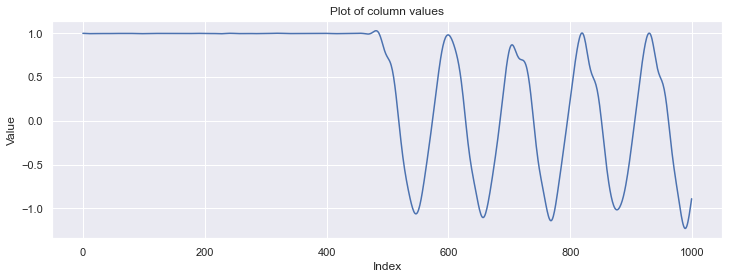

In [18]:
df['accel_2_x'][:1000].plot()
plt.title('Plot of column values')
plt.xlabel('Index')
plt.ylabel('Value')
plt.show()

In [19]:
imu_data['IMU2GyroZ_rad'] = (imu_data['IMU2GyroZ'] * np.pi ) /180 
imu_data['IMU2GyroX_rad'] = (imu_data['IMU2GyroX'] * np.pi ) /180 
imu_data['IMU2GyroY_rad'] = (imu_data['IMU2GyroY'] * np.pi ) /180 

In [20]:
imu_data

,Sampled Time (ms),Encoder (deg),IMU2q0,IMU2q1,IMU2q2,IMU2q3,IMU1q0,IMU1q1,IMU1q2,IMU1q3,...,IMU2AccelZ,IMU1GyroX,IMU1GyroY,IMU1GyroZ,IMU1AccelX,IMU1AccelY,IMU1AccelZ,IMU2GyroZ_rad,IMU2GyroX_rad,IMU2GyroY_rad
1,1940608,0.79,0.67,0.21,-0.69,0.20,-0.71,0.05,0.71,0.04,...,-0.04,0.00,-0.06,2.56,1.02,0.00,0.00,-0.001047,-0.001047,-0.001047
2,1940622,6.23,0.68,0.20,-0.67,0.21,-0.71,0.05,0.71,0.04,...,-0.34,0.00,0.00,0.49,1.00,-0.01,0.00,0.020246,0.115017,6.290690
3,1940632,9.13,0.70,0.19,-0.65,0.22,-0.71,0.05,0.71,0.04,...,0.21,0.00,-0.12,-1.95,1.02,-0.01,-0.01,0.023387,0.192684,7.526209
4,1940642,12.11,0.72,0.19,-0.63,0.22,-0.71,0.05,0.71,0.04,...,0.89,0.12,-0.06,-0.30,1.02,-0.02,-0.00,0.015882,0.201062,7.451683
5,1940652,15.27,0.74,0.18,-0.61,0.23,-0.71,0.05,0.71,0.04,...,0.73,-0.06,0.37,0.79,1.01,0.01,0.01,-0.013788,0.161792,6.980270
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149827,3440556,104.33,-0.79,0.06,-0.07,-0.61,-0.68,0.20,0.68,0.19,...,1.22,-0.06,-0.24,-3.66,1.01,-0.04,0.00,-0.036128,0.069115,3.673744
149828,3440566,107.93,-0.78,0.08,-0.09,-0.61,-0.68,0.20,0.68,0.19,...,0.97,-0.06,-0.30,-3.96,1.01,-0.00,0.00,0.006458,0.039444,3.929085
149829,3440576,111.35,-0.78,0.09,-0.12,-0.61,-0.68,0.20,0.68,0.19,...,0.57,0.00,-0.37,5.98,1.01,0.02,0.02,0.034034,0.060737,4.940154
149830,3440586,114.34,-0.78,0.11,-0.14,-0.60,-0.68,0.20,0.68,0.19,...,0.66,0.06,-0.49,3.11,1.02,0.02,0.01,0.040492,0.119206,6.135181


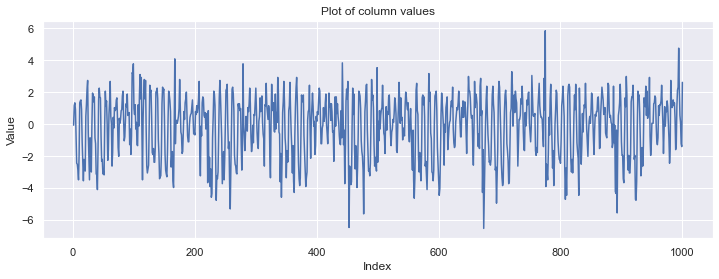

In [21]:
imu_data['IMU2GyroZ'][:1000].plot()
plt.title('Plot of column values')
plt.xlabel('Index')
plt.ylabel('Value')
plt.show()

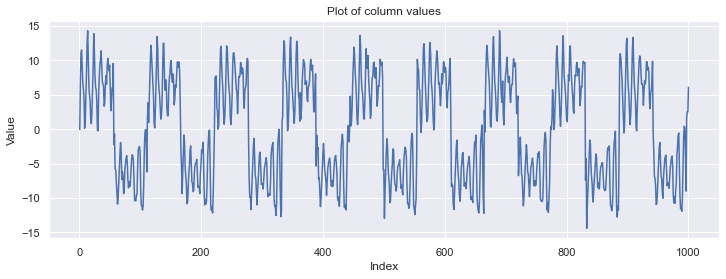

In [22]:
imu_data['IMU2GyroX'][:1000].plot()
plt.title('Plot of column values')
plt.xlabel('Index')
plt.ylabel('Value')
plt.show()

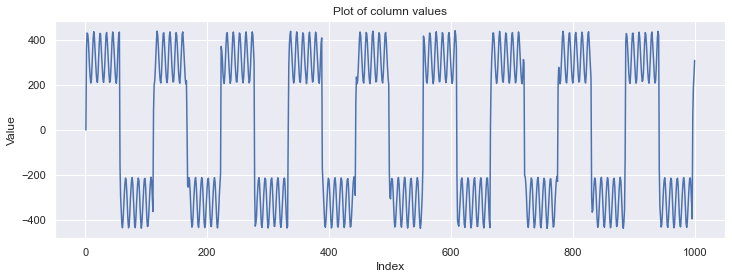

In [23]:
imu_data['IMU2GyroY'][:1000].plot()
plt.title('Plot of column values')
plt.xlabel('Index')
plt.ylabel('Value')
plt.show()

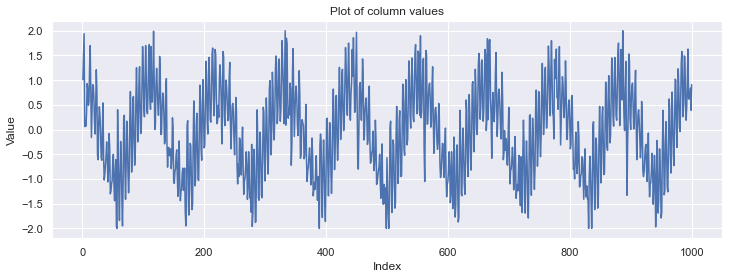

In [24]:
imu_data['IMU2AccelX'][:1000].plot()
plt.title('Plot of column values')
plt.xlabel('Index')
plt.ylabel('Value')
plt.show()

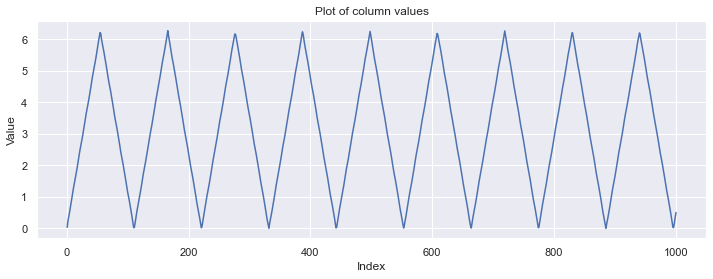

In [25]:
(imu_data['Encoder (deg)'][:1000]*2*np.pi/180).plot()
plt.title('Plot of column values')
plt.xlabel('Index')
plt.ylabel('Value')
plt.show()

In [26]:
df

,time,encoder,accel_2_x,accel_2_y,accel_2_z,ai_angle_1,ai_angle_2,ai_angle,gi_angle_1,gi_angle_2,...,cf_angle_2,cf_angle,kf_angle_1,kf_angle_2,kf_angle,angle_ref_2,dmp_angle_2,angle_ref_1,dmp_angle_1,dmp_angle
0,0.000,0.00,0.999570,-2.352378e-07,-0.030165,0.000000,0.000000,0.000000,0.000000,0.000000,...,-0.000582,0.000485,0.000000,0.000000,0.000000,0,0.000000,0,0.000000,0.000000
1,0.010,0.00,0.999194,-5.665334e-07,-0.030098,-180.000000,-178.274619,1.725381,-0.001053,-0.000583,...,-1.783895,0.018180,-1.783391,-1.765860,0.017531,0,1.042474,0,0.174515,0.867959
2,0.020,0.00,0.998810,-9.281888e-07,-0.030008,-180.000000,-178.279166,1.720834,-0.002059,-0.001155,...,-3.549408,0.035620,-3.532489,-3.497837,0.034652,0,1.042473,0,0.174517,0.867956
3,0.030,0.00,0.998427,-1.301478e-06,-0.029893,-180.000000,-178.285086,1.714914,-0.003022,-0.001715,...,-5.297313,0.052798,-5.248801,-5.197431,0.051371,0,1.042471,0,0.174519,0.867952
4,0.040,0.00,0.998052,-1.662926e-06,-0.029756,-180.000000,-178.292302,1.707698,-0.003946,-0.002262,...,-7.027797,0.069709,-6.933767,-6.866072,0.067695,0,1.042470,0,0.174522,0.867948
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150309,1510.045,78.89,-0.028297,1.161914e-01,1.034539,-179.771887,-88.443005,91.328882,-86.110615,73.328455,...,-102.077993,77.621469,-179.621894,-102.099754,77.522140,0,78.117352,0,0.726193,77.391160
150310,1510.055,81.70,-0.131743,1.432879e-01,1.069047,-179.813610,-83.036290,96.777320,-86.113442,76.730098,...,-98.494745,81.208615,-179.624537,-98.632878,80.991659,0,80.869411,0,0.726193,80.143218
150311,1510.065,84.59,-0.231848,1.704285e-01,1.101594,-179.854276,-78.250490,101.603786,-86.116172,80.187105,...,-94.840259,84.867259,-179.627168,-95.102955,84.524212,0,83.367203,0,0.726193,82.641010
150312,1510.075,87.57,-0.326085,1.967688e-01,1.131727,-179.892451,-74.152244,105.740206,-86.118788,83.706405,...,-91.117208,88.594690,-179.629770,-91.506929,88.122841,0,85.588563,0,0.726193,84.862370


In [27]:
imu_data

,Sampled Time (ms),Encoder (deg),IMU2q0,IMU2q1,IMU2q2,IMU2q3,IMU1q0,IMU1q1,IMU1q2,IMU1q3,...,IMU2AccelZ,IMU1GyroX,IMU1GyroY,IMU1GyroZ,IMU1AccelX,IMU1AccelY,IMU1AccelZ,IMU2GyroZ_rad,IMU2GyroX_rad,IMU2GyroY_rad
1,1940608,0.79,0.67,0.21,-0.69,0.20,-0.71,0.05,0.71,0.04,...,-0.04,0.00,-0.06,2.56,1.02,0.00,0.00,-0.001047,-0.001047,-0.001047
2,1940622,6.23,0.68,0.20,-0.67,0.21,-0.71,0.05,0.71,0.04,...,-0.34,0.00,0.00,0.49,1.00,-0.01,0.00,0.020246,0.115017,6.290690
3,1940632,9.13,0.70,0.19,-0.65,0.22,-0.71,0.05,0.71,0.04,...,0.21,0.00,-0.12,-1.95,1.02,-0.01,-0.01,0.023387,0.192684,7.526209
4,1940642,12.11,0.72,0.19,-0.63,0.22,-0.71,0.05,0.71,0.04,...,0.89,0.12,-0.06,-0.30,1.02,-0.02,-0.00,0.015882,0.201062,7.451683
5,1940652,15.27,0.74,0.18,-0.61,0.23,-0.71,0.05,0.71,0.04,...,0.73,-0.06,0.37,0.79,1.01,0.01,0.01,-0.013788,0.161792,6.980270
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149827,3440556,104.33,-0.79,0.06,-0.07,-0.61,-0.68,0.20,0.68,0.19,...,1.22,-0.06,-0.24,-3.66,1.01,-0.04,0.00,-0.036128,0.069115,3.673744
149828,3440566,107.93,-0.78,0.08,-0.09,-0.61,-0.68,0.20,0.68,0.19,...,0.97,-0.06,-0.30,-3.96,1.01,-0.00,0.00,0.006458,0.039444,3.929085
149829,3440576,111.35,-0.78,0.09,-0.12,-0.61,-0.68,0.20,0.68,0.19,...,0.57,0.00,-0.37,5.98,1.01,0.02,0.02,0.034034,0.060737,4.940154
149830,3440586,114.34,-0.78,0.11,-0.14,-0.60,-0.68,0.20,0.68,0.19,...,0.66,0.06,-0.49,3.11,1.02,0.02,0.01,0.040492,0.119206,6.135181


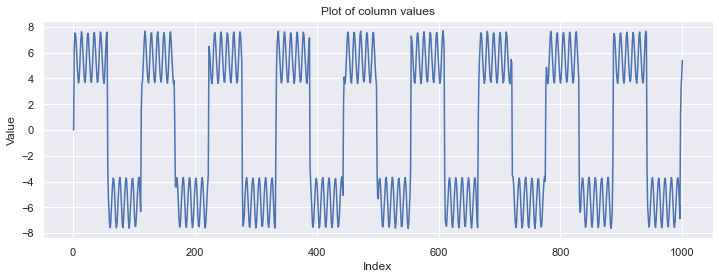

In [28]:
imu_data['IMU2GyroY_rad'][:1000].plot()
plt.title('Plot of column values')
plt.xlabel('Index')
plt.ylabel('Value')
plt.show()

In [46]:
from madgwick_py.madgwickahrs import MadgwickAHRS
from madgwick_py.quaternion import Quaternion
from ahrs.filters.madgwick import Madgwick
from ahrs.filters.mahony import Mahony
from ahrs.filters.ekf import EKF

In [30]:
sample_period = 1/100  # Sample period of 1/256 seconds
beta = 1  # Default gain value
madgwick_custom = MadgwickAHRS(sampleperiod=sample_period, beta=beta)

In [31]:
imu_data["Sampled Time (ms)"][1]

'1940608'

In [32]:
imu_data

,Sampled Time (ms),Encoder (deg),IMU2q0,IMU2q1,IMU2q2,IMU2q3,IMU1q0,IMU1q1,IMU1q2,IMU1q3,...,IMU2AccelZ,IMU1GyroX,IMU1GyroY,IMU1GyroZ,IMU1AccelX,IMU1AccelY,IMU1AccelZ,IMU2GyroZ_rad,IMU2GyroX_rad,IMU2GyroY_rad
1,1940608,0.79,0.67,0.21,-0.69,0.20,-0.71,0.05,0.71,0.04,...,-0.04,0.00,-0.06,2.56,1.02,0.00,0.00,-0.001047,-0.001047,-0.001047
2,1940622,6.23,0.68,0.20,-0.67,0.21,-0.71,0.05,0.71,0.04,...,-0.34,0.00,0.00,0.49,1.00,-0.01,0.00,0.020246,0.115017,6.290690
3,1940632,9.13,0.70,0.19,-0.65,0.22,-0.71,0.05,0.71,0.04,...,0.21,0.00,-0.12,-1.95,1.02,-0.01,-0.01,0.023387,0.192684,7.526209
4,1940642,12.11,0.72,0.19,-0.63,0.22,-0.71,0.05,0.71,0.04,...,0.89,0.12,-0.06,-0.30,1.02,-0.02,-0.00,0.015882,0.201062,7.451683
5,1940652,15.27,0.74,0.18,-0.61,0.23,-0.71,0.05,0.71,0.04,...,0.73,-0.06,0.37,0.79,1.01,0.01,0.01,-0.013788,0.161792,6.980270
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149827,3440556,104.33,-0.79,0.06,-0.07,-0.61,-0.68,0.20,0.68,0.19,...,1.22,-0.06,-0.24,-3.66,1.01,-0.04,0.00,-0.036128,0.069115,3.673744
149828,3440566,107.93,-0.78,0.08,-0.09,-0.61,-0.68,0.20,0.68,0.19,...,0.97,-0.06,-0.30,-3.96,1.01,-0.00,0.00,0.006458,0.039444,3.929085
149829,3440576,111.35,-0.78,0.09,-0.12,-0.61,-0.68,0.20,0.68,0.19,...,0.57,0.00,-0.37,5.98,1.01,0.02,0.02,0.034034,0.060737,4.940154
149830,3440586,114.34,-0.78,0.11,-0.14,-0.60,-0.68,0.20,0.68,0.19,...,0.66,0.06,-0.49,3.11,1.02,0.02,0.01,0.040492,0.119206,6.135181


# Plot given Q values

In [33]:
def euler_values_from_q():
    time_prev = int(imu_data["Sampled Time (ms)"][1]) - 10
    
    euler_angle = []
    
    for index, row in imu_data.iterrows():
        # Extract gyroscope, accelerometer and magnetometer values from each row
        q_val = np.array([row['IMU2q0'], row['IMU2q1'], row['IMU2q2'], row['IMU2q3']])
        
#         print(q_val)
        
        quaternion = Quaternion(w_or_q = q_val)
#         print(q_val)
        
        try:
            euler_angle.append(quaternion.to_euler_angles())
        except:
            euler_angle.append([0,0,0])
        
        
        
    return np.array(euler_angle)

euler_angle = euler_values_from_q()

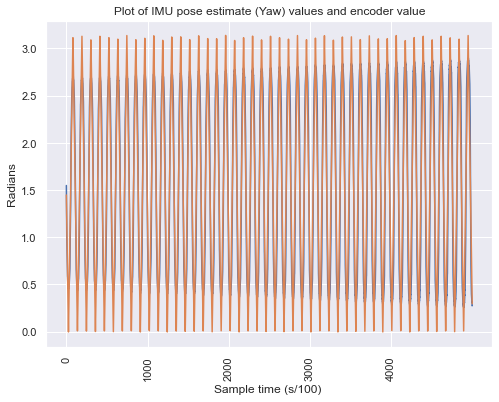

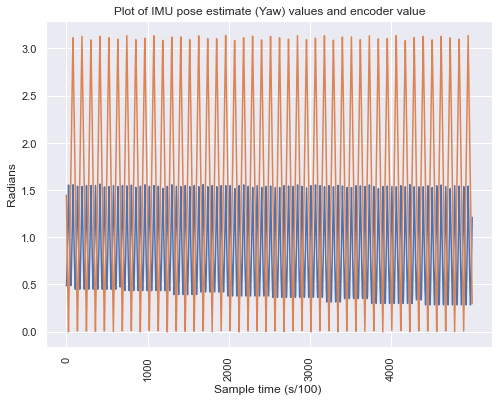

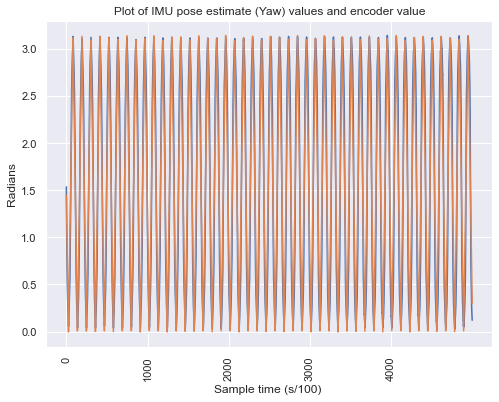

In [34]:
plot_euler(euler_angle, 45000, 50000, 1000)

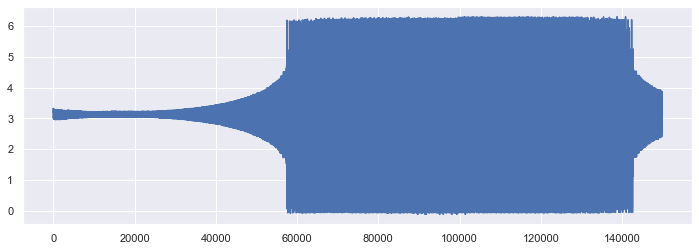

In [34]:
plt.plot(imu_data['Encoder (deg)'][:]*np.pi/180 - euler_angle[:,2]+np.pi/2)

In [35]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation

# Function to convert Euler angles to rotation matrix
def euler_to_rotation_matrix(roll, pitch, yaw):
    R_x = np.array([[1, 0, 0],
                    [0, np.cos(roll), -np.sin(roll)],
                    [0, np.sin(roll), np.cos(roll)]])

    R_y = np.array([[np.cos(pitch), 0, np.sin(pitch)],
                    [0, 1, 0],
                    [-np.sin(pitch), 0, np.cos(pitch)]])

    R_z = np.array([[np.cos(yaw), -np.sin(yaw), 0],
                    [np.sin(yaw), np.cos(yaw), 0],
                    [0, 0, 1]])

    R = np.dot(R_z, np.dot(R_y, R_x))

    return R


# Function to update the plot for each frame
def update(frame):
    global R, origin, x_axis, y_axis, z_axis

    # Clear the current plot
    ax.clear()

    # Define your Euler angles (in radians) here, you can use your IMU data or any other source
    roll, pitch, yaw = np.radians([frame, 45, 60])

    # Compute the rotation matrix
    R = euler_to_rotation_matrix(roll, pitch, yaw)

    # Rotate the coordinate frame
    x_axis_rotated = np.dot(R, x_axis)
    y_axis_rotated = np.dot(R, y_axis)
    z_axis_rotated = np.dot(R, z_axis)

    # Plot the original coordinate frame
    ax.quiver(*origin, *x_axis, color='r', label='X-axis')
    ax.quiver(*origin, *y_axis, color='g', label='Y-axis')
    ax.quiver(*origin, *z_axis, color='b', label='Z-axis')

    # Plot the rotated coordinate frame
    ax.quiver(*origin, *x_axis_rotated, color='r', linestyle='dashed')
    ax.quiver(*origin, *y_axis_rotated, color='g', linestyle='dashed')
    ax.quiver(*origin, *z_axis_rotated, color='b', linestyle='dashed')

    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_xlim(-1, 1)
    ax.set_ylim(-1, 1)
    ax.set_zlim(-1, 1)
    ax.legend()


In [36]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)


In [37]:
import numpy as np
import pythreejs as p3
import time
import ipywidgets as widgets
from IPython.display import display


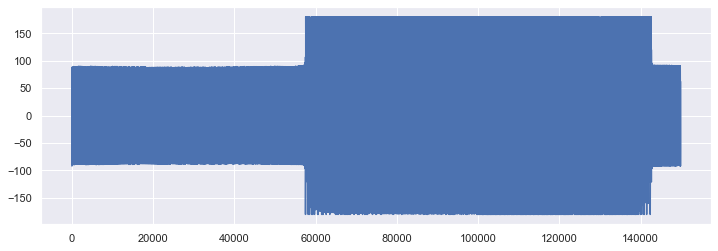

In [38]:
plt.plot((euler_angle*180/np.pi)[:,2])

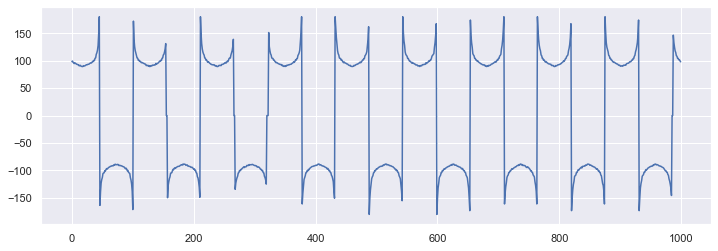

In [39]:
plt.plot((euler_angle*180/np.pi)[60000:61000,2])

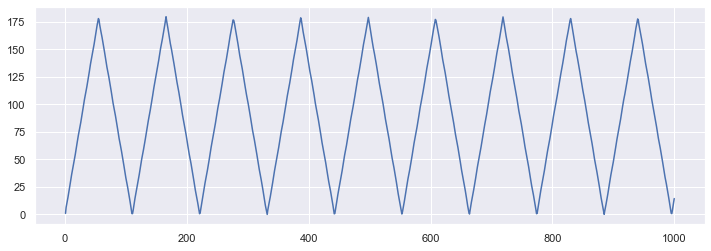

In [44]:
plt.plot(imu_data['Encoder (deg)'][:1000])

In [43]:
def rotation_matrix_y(angle):
    c, s = np.cos(angle), np.sin(angle)
    return np.array([[c, 0, s], [0, 1, 0], [-s, 0, c]])

def update_yaw(change):
    angle = np.deg2rad(yaw_angles[change.new])
    rotation_matrix = rotation_matrix_y(angle)
    x_axis_rotated = rotation_matrix.dot(x_axis)
    y_axis_rotated = rotation_matrix.dot(y_axis)
    z_axis_rotated = rotation_matrix.dot(z_axis)

    arrow_x_new = p3.ArrowHelper(origin=tuple(origin), dir=tuple(x_axis_rotated), color='red', length=1)
    arrow_y_new = p3.ArrowHelper(origin=tuple(origin), dir=tuple(y_axis_rotated), color='green', length=1)
    arrow_z_new = p3.ArrowHelper(origin=tuple(origin), dir=tuple(z_axis_rotated), color='blue', length=1)

    scene.children = [arrow_x_new, arrow_y_new, arrow_z_new, camera, key_light, ambient_light]

# yaw_angles = np.linspace(-180, 180, 100)
# yaw_angles = (euler_angle*180/np.pi)[:1000,2]
yaw_angles = (imu_data['Encoder (deg)'])[:1000]

origin = np.array([0, 0, 0])
x_axis = np.array([1, 0, 0])
y_axis = np.array([0, 1, 0])
z_axis = np.array([0, 0, 1])

camera = p3.PerspectiveCamera(position=[3, 3, 3], up=[0, 0, 1])
key_light = p3.DirectionalLight(position=[0, 10, 10])
ambient_light = p3.AmbientLight()

arrow_x = p3.ArrowHelper(origin=tuple(origin), dir=tuple(x_axis), color='red', length=1)
arrow_y = p3.ArrowHelper(origin=tuple(origin), dir=tuple(y_axis), color='green', length=1)
arrow_z = p3.ArrowHelper(origin=tuple(origin), dir=tuple(z_axis), color='blue', length=1)

scene = p3.Scene(children=[arrow_x, arrow_y, arrow_z, camera, key_light, ambient_light])
controller = p3.OrbitControls(controlling=camera)

renderer = p3.Renderer(camera=camera, scene=scene, controls=[controller])

play_widget = widgets.Play(
    value=0, min=0, max=len(yaw_angles)-1, step=1, interval=100, description="Press play"
)
play_widget.observe(update_yaw, names='value')

widgets.VBox([renderer, play_widget])


In [ ]:
np.arange(0, 360, 5)

In [ ]:
# Create a 3D plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Create a 3D coordinate frame
origin = np.array([0, 0, 0])
x_axis = np.array([1, 0, 0])
y_axis = np.array([0, 1, 0])
z_axis = np.array([0, 0, 1])

# Create the animation
ani = FuncAnimation(fig, update, frames=np.arange(0, 360, 5), interval=100)

# Display the animation
plt.show()

# Define functions to get and plot angles

In [51]:
def euler_values_ahrs(custom_function):
    angle_axes = []
    euler_angle = []
    Q_prev = np.array([1., 0., 0., 0.])
    time_prev = int(imu_data["Sampled Time (ms)"][1]) - 10
    
    gyro_data = []
    acc_data = []
    
    for index, row in imu_data.iterrows():
        # Extract gyroscope, accelerometer and magnetometer values from each row
        gyroscope = [row['IMU2GyroX_rad'], row['IMU2GyroY_rad'], row['IMU2GyroZ_rad']]
        accelerometer = [row['IMU2AccelX']*9.806, row['IMU2AccelY']*9.806, row['IMU2AccelZ']*9.806]
        
        gyro_data.append(gyroscope)
        acc_data.append(accelerometer)
        
        quaternion = Quaternion(w_or_q = Q_prev)

        angle_axes.append(quaternion.to_angle_axis())
        euler_angle.append(quaternion.to_euler_angles())
        
        time_curr = int(row["Sampled Time (ms)"])
        delta_t = (time_curr -  time_prev) / 1000
        time_prev = time_curr
        
        Q = custom_function.updateIMU(q = Q_prev, gyr=gyroscope, acc=accelerometer, dt = delta_t)

        Q_prev = Q
        
    return np.array(euler_angle)


def euler_values(custom_function):
    custom_function.reset_q()
    angle_axes = []
    euler_angle = []
    for index, row in imu_data.iterrows():
        # Extract gyroscope, accelerometer and magnetometer values from each row
        gyroscope = [row['IMU2GyroX_rad'], row['IMU2GyroY_rad'], row['IMU2GyroZ_rad']]
        accelerometer = [row['IMU2AccelX']*9.81, row['IMU2AccelY']*9.81, row['IMU2AccelZ']*9.81]


        custom_function.update_imu(gyroscope, accelerometer)
        angle_axes.append(custom_function.quaternion.to_angle_axis())
        euler_angle.append(custom_function.quaternion.to_euler_angles())
        
    return np.array(euler_angle)

def custom_plot(x, euler_angle, idx, range_start, range_end, diff):
    
    xticks = np.arange(0, len(x), diff)
    
    # graph angles in degrees for angles list
    fig, ax = plt.subplots(figsize=(8, 6))
    ax.plot(x, euler_angle[range_start:range_end, idx]+np.pi/2, label= 'Euler angle (Yaw)')
    ax.plot(x, imu_data['Encoder (deg)'][range_start:range_end]*np.pi/180, label= 'Encoder')

    ax.set_xticks(xticks)
    
    # Make the x and y axis labels perpendicular
    ax.tick_params(axis='x', labelrotation=90)
    ax.tick_params(axis='y', labelrotation=0)
    
    plt.title('Plot of IMU pose estimate (Yaw) values and encoder value')
    plt.xlabel('Sample time (s/100) ')
    plt.ylabel('Radians')
    
    plt.show()
    
def plot_euler(euler_angle, range_start, range_end, diff):
    
    x = imu_data['Sampled Time (ms)'][range_start:range_end].astype(int)
    x = np.arange(len(imu_data['Sampled Time (ms)'][range_start:range_end]))
    
    for i in range(3):
        custom_plot(x, euler_angle, i, range_start, range_end, diff)
        
def compute_rmse(signal_1, signal_2):
    # Compute the RMSE
    rmse = np.sqrt(np.mean((signal_1 - signal_2) ** 2))

    # Print the RMSE
    print("RMSE between signal_1 and signal_2: {:.3f}".format(rmse))

# Run functions for different algorithms

### Madgwick ahrs

In [52]:
imu_data['IMU2GyroZ_rad'] = (imu_data['IMU2GyroZ'] * np.pi) /180 
imu_data['IMU2GyroX_rad'] = (imu_data['IMU2GyroX'] * np.pi) /180 
imu_data['IMU2GyroY_rad'] = (imu_data['IMU2GyroY'] * np.pi) /180 

In [53]:
madgwick_ahrs = Madgwick()

In [54]:
madgwick_ahrs

In [55]:
euler_angle = euler_values_ahrs(madgwick_ahrs)

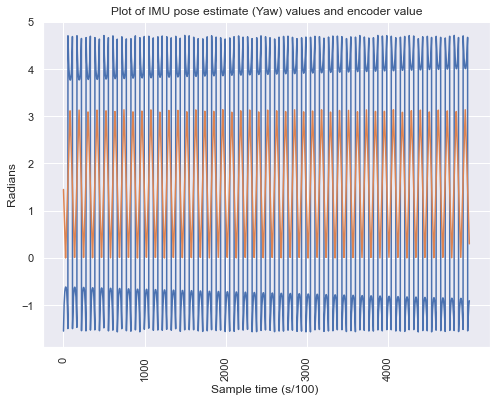

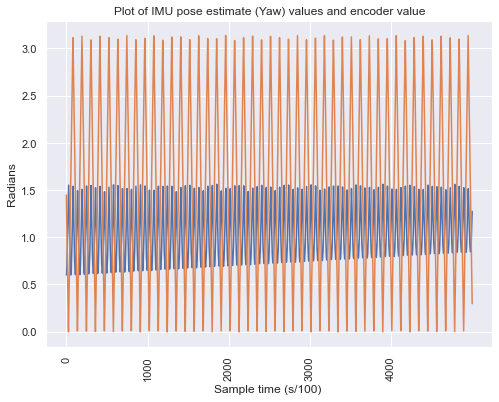

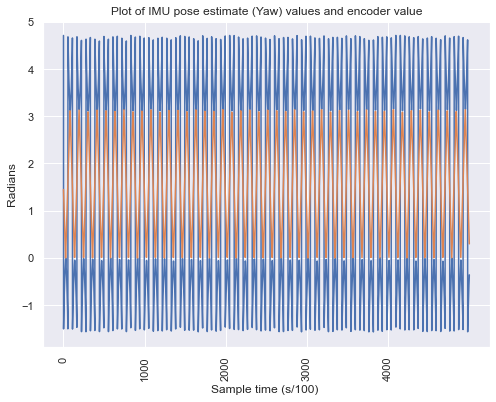

In [73]:
plot_euler(euler_angle, 45000, 50000, 1000)

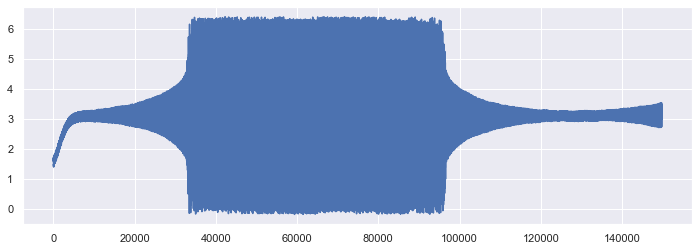

In [74]:
plt.plot(imu_data['Encoder (deg)'][:]*np.pi/180 - euler_angle[:,2]+np.pi/2)

In [75]:
compute_rmse(euler_angle[:,2]+np.pi/2, imu_data['Encoder (deg)'][:]*np.pi/180)

compute_rmse(euler_angle[:,1]+np.pi/2, imu_data['Encoder (deg)']*np.pi/180)
compute_rmse(euler_angle[:,0]+np.pi/2, imu_data['Encoder (deg)']*np.pi/180)

RMSE between signal_1 and signal_2: 1.112
RMSE between signal_1 and signal_2: 1.065
RMSE between signal_1 and signal_2: 1.965


### Mahony ahrs

In [76]:
imu_data['IMU2GyroZ_rad'] = (imu_data['IMU2GyroZ'] * 2*np.pi) /180 
imu_data['IMU2GyroX_rad'] = (imu_data['IMU2GyroX'] * 2*np.pi) /180 
imu_data['IMU2GyroY_rad'] = (imu_data['IMU2GyroY'] * 2*np.pi) /180 

In [77]:
mahony_ahrs = Mahony()

In [78]:
euler_angle = euler_values_ahrs(mahony_ahrs)

In [79]:
euler_angle.shape

(149831, 3)

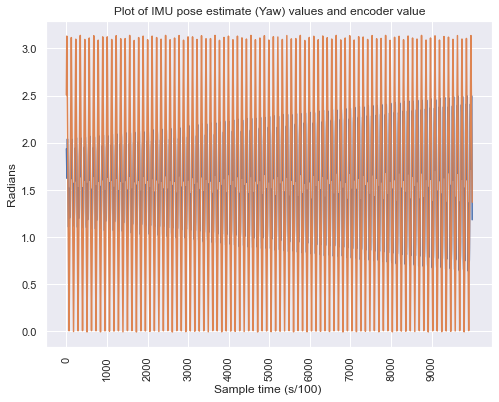

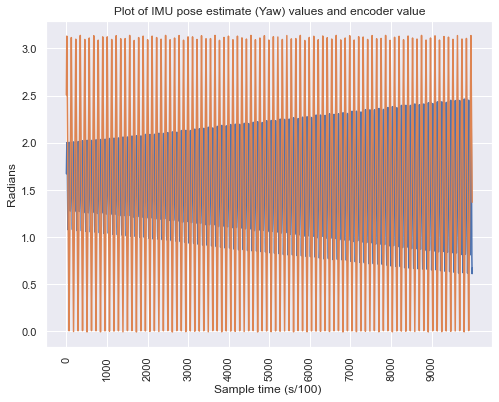

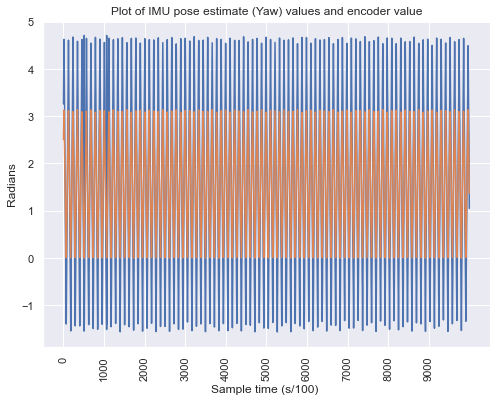

In [80]:
plot_euler(euler_angle, 10000, 20000, 1000)

In [81]:
compute_rmse(euler_angle[:,2]+np.pi, imu_data['Encoder (deg)'][:]*2*np.pi/180)

compute_rmse(euler_angle[:,1]+np.pi, imu_data['Encoder (deg)']*2*np.pi/180)
compute_rmse(euler_angle[:,0]+np.pi, imu_data['Encoder (deg)']*2*np.pi/180)

RMSE between signal_1 and signal_2: 2.041
RMSE between signal_1 and signal_2: 1.903
RMSE between signal_1 and signal_2: 2.368


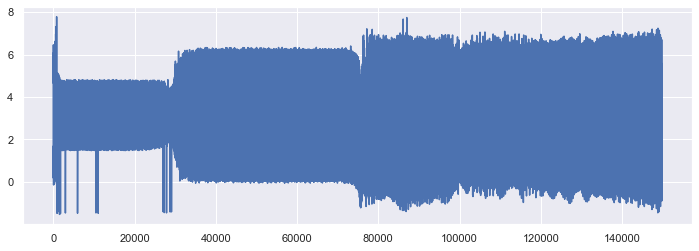

In [82]:
plt.plot(imu_data['Encoder (deg)'][:]*np.pi/180 - euler_angle[:,2]+np.pi/2)

### EKF ahrs

In [83]:
def euler_values_ahrs(custom_function):
    angle_axes = []
    euler_angle = []
    Q_prev = np.array([1., 0., 0., 0.])
    time_prev = int(imu_data["Sampled Time (ms)"][1]) - 10
    
    gyro_data = []
    acc_data = []
    
    for index, row in imu_data.iterrows():
        # Extract gyroscope, accelerometer and magnetometer values from each row
        gyroscope = [row['IMU2GyroX_rad'], row['IMU2GyroY_rad'], row['IMU2GyroZ_rad']]
        accelerometer = [row['IMU2AccelX']*9.806, row['IMU2AccelY']*9.806, row['IMU2AccelZ']*9.806]
        
        gyro_data.append(gyroscope)
        acc_data.append(accelerometer)
        
        quaternion = Quaternion(w_or_q = Q_prev)

        angle_axes.append(quaternion.to_angle_axis())
        euler_angle.append(quaternion.to_euler_angles())
        
        time_curr = int(row["Sampled Time (ms)"])
        delta_t = (time_curr -  time_prev) / 1000
        time_prev = time_curr
        
        Q = custom_function.update(q = Q_prev, gyr=gyroscope, acc=accelerometer, mag = None, dt = delta_t)

        Q_prev = Q
        
    return np.array(euler_angle)

In [84]:
imu_data['IMU2GyroZ_rad'] = (imu_data['IMU2GyroZ'] * 2*np.pi) /180 
imu_data['IMU2GyroX_rad'] = (imu_data['IMU2GyroX'] * 2*np.pi) /180 
imu_data['IMU2GyroY_rad'] = (imu_data['IMU2GyroY'] * 2*np.pi) /180 

In [85]:
ekf_ahrs = EKF()

In [86]:
euler_angle = euler_values_ahrs(ekf_ahrs)

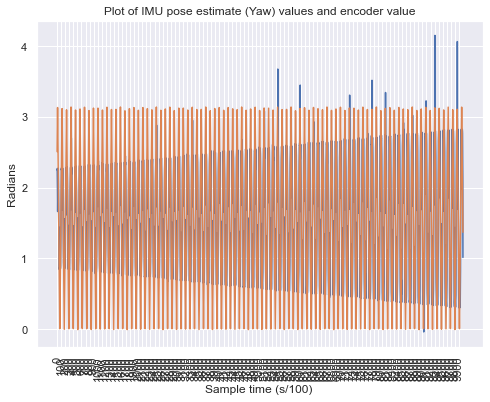

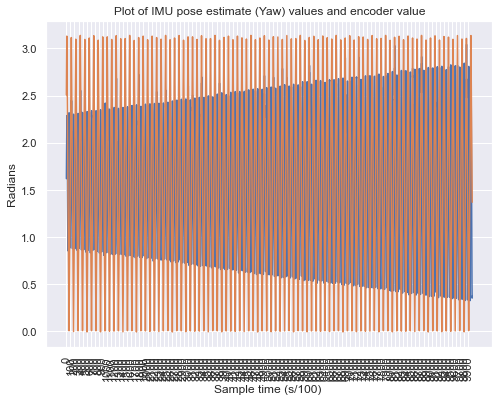

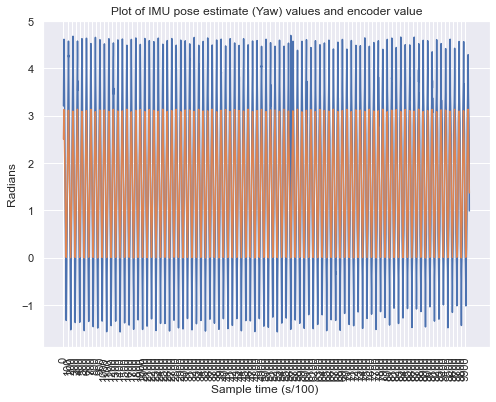

In [87]:
plot_euler(euler_angle, 10000, 20000, 100)

In [88]:
compute_rmse(euler_angle[:,2]+np.pi, imu_data['Encoder (deg)'][:]*2*np.pi/180)

compute_rmse(euler_angle[:,1]+np.pi, imu_data['Encoder (deg)']*2*np.pi/180)
compute_rmse(euler_angle[:,0]+np.pi, imu_data['Encoder (deg)']*2*np.pi/180)

RMSE between signal_1 and signal_2: 1.123
RMSE between signal_1 and signal_2: 1.906
RMSE between signal_1 and signal_2: 2.364


In [89]:
euler_angle = []

gyro_data = np.array(imu_data[['IMU2GyroX_rad', 'IMU2GyroY_rad', 'IMU2GyroZ_rad']].values.tolist())
acc_data = np.array((imu_data[['IMU2AccelX', 'IMU2AccelY', 'IMU2AccelZ']] * 9.806).values.tolist())

madgwick_ahrs = Madgwick(gyr=gyro_data, acc=acc_data, frequency=100.0) 
Q_all = madgwick_ahrs._compute_all()
for i in range(len(Q_all)):
    quaternion = Quaternion(w_or_q = Q_all[i])
    euler_angle.append(quaternion.to_euler_angles())

In [90]:
euler_angle = np.array(euler_angle)

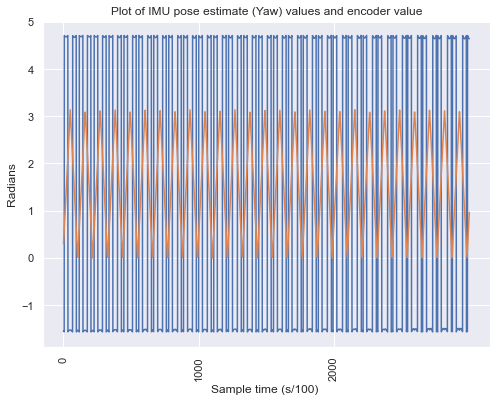

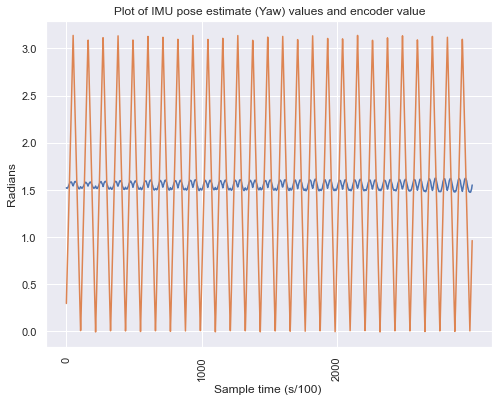

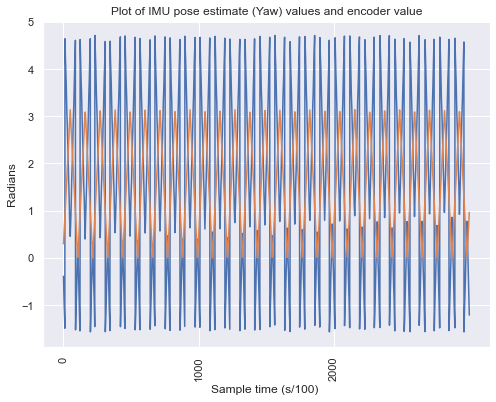

In [91]:
plot_euler(euler_angle, 1000, 4000, 1000)

In [92]:
compute_rmse(euler_angle[:,2]+np.pi, imu_data['Encoder (deg)'][:]*2*np.pi/180)

compute_rmse(euler_angle[:,1]+np.pi, imu_data['Encoder (deg)']*2*np.pi/180)
compute_rmse(euler_angle[:,0]+np.pi, imu_data['Encoder (deg)']*2*np.pi/180)

RMSE between signal_1 and signal_2: 1.320
RMSE between signal_1 and signal_2: 1.893
RMSE between signal_1 and signal_2: 2.970


In [ ]:
euler_angle_custom = euler_values(madgwick_custom)

In [ ]:
plot_euler(euler_angle_custom, 0, 1000, 1000)

In [ ]:
compute_rmse(euler_angle[:,2]+np.pi, imu_data['Encoder (deg)']*2*np.pi/180)

compute_rmse(euler_angle[:,1]+np.pi, imu_data['Encoder (deg)']*2*np.pi/180)
compute_rmse(euler_angle[:,0]+np.pi, imu_data['Encoder (deg)']*2*np.pi/180)




# Neural Network

In [ ]:
imu_data

In [ ]:
import numpy as np
import pandas as pd
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

In [ ]:
# Extract the input features (IMU2 values) and output (Encoder) from the DataFrame
input_features = imu_data[['IMU2GyroX', 'IMU2GyroY', 'IMU2GyroZ', 'IMU2AccelX', 'IMU2AccelY', 'IMU2AccelZ']].values
output = df['Encoder (deg)'].values

In [ ]:
# Normalize the data
scaler = MinMaxScaler()
input_features = scaler.fit_transform(input_features)

# Function to create the dataset for LSTM input
def create_dataset(X, y, time_steps):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i+time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

# Create the dataset with time steps
time_steps = 10
X, y = create_dataset(input_features, output, time_steps)

# Reshape the input to fit the LSTM input format
X = X.reshape(X.shape[0], time_steps, input_features.shape[1])

In [ ]:
# Define the LSTM model
model = Sequential()
model.add(LSTM(64, input_shape=(time_steps, input_features.shape[1])))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Train the model
model.fit(X, y, epochs=100, batch_size=32, verbose=1)

In [ ]:
# Make predictions
y_pred = model.predict(X)

# Calculate the Mean Squared Error
mse = mean_squared_error(y, y_pred)
print('Mean Squared Error:', mse)

# Print the actual Encoder values and predicted values for comparison
print('Actual Encoder values:', y)
print('Predicted Encoder values:', y_pred.flatten())

In [ ]:
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the model on the training set
model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=1)

# Make predictions on the test set
y_test_pred = model.predict(X_test)

# Calculate the Mean Squared Error for the test set
mse_test = mean_squared_error(y_test, y_test_pred)
print('Test Mean Squared Error:', mse_test)

# Visualize the actual and predicted encoder values
plt.plot(y_test, label='Actual Encoder values')
plt.plot(y_test_pred.flatten(), label='Predicted Encoder values')
plt.legend()
plt.xlabel('Sample index')
plt.ylabel('Encoder (deg)')
plt.title('Actual vs Predicted Encoder values')
plt.show()